In [2]:
import numpy as np
import matplotlib.pyplot as plt
import pydot
import pickle
import pathlib
import os
from scipy import stats
import random
from sklearn.metrics import r2_score
plt.rcParams['figure.figsize'] = [10, 5]
#import unicode

from scipy.optimize import curve_fit
import re
from sklearn.cluster import AgglomerativeClustering
import pandas as pd
import statistics
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster

from sklearn.neighbors import NearestNeighbors
from scipy.spatial import distance
from sklearn.decomposition import PCA
from sklearn.metrics.pairwise import cosine_similarity

In [3]:
#directory = str(pathlib.Path(__file__).parent.resolve())
#script_path = str(pathlib.Path(__file__).parent.resolve())
directory = os.getcwd()
script_path = os.getcwd()
nameset,dictset = [],[]
refnameset,refdictset = [],[]

refsortset = []
sortset = []


for filename in os.listdir(directory):
    if filename.endswith(".txt") and '._' not in filename and 'mat' not in filename:
        if 'REF' not in filename:
            impath = os.path.join(directory, filename)
            nameset.append(impath)
            this_set = dict()
            with (open(impath, encoding = 'utf8', errors = 'ignore')) as f: #populate dict from text file
                for n in f:
                    pog = n.split('\t')
                    this_set[pog[0]] = pog[-1].count(',')
                f.close()
            try:
                this_set.pop('cell_name')
                this_set.pop('AB')
            except: pass
            dictset.append(this_set)
            sortset.append((impath, this_set))
        else:
            impath = os.path.join(directory, filename)
            refnameset.append(impath)
            this_set = dict()
            with (open(impath, encoding = 'utf8', errors = 'ignore')) as f: #populate dict from text file
                for n in f:
                    pog = n.split('\t')
                    this_set[pog[0]] = pog[-1].count(',')
                    #if pog[0] == 'P4': print(pog[0],pog[-1].count(','))
                f.close()
            try:
                this_set.pop('cell_name')
                this_set.pop('AB')
            except: pass
            refdictset.append(this_set)
            refsortset.append((impath, this_set))
            
    
print(len(dictset),len(nameset))
print(len(refdictset),len(refnameset))
truncator = len(nameset)

nameset,dictset = [],[]
for n in sorted(sortset):
    nameset.append(n[0]);dictset.append(n[1])

refnameset,refdictset = [],[]
for n in sorted(refsortset):
    refnameset.append(n[0]);refdictset.append(n[1])
    
fulldictset = refdictset + dictset;fullnameset = refnameset + nameset

1322 1322
30 30


In [4]:
def remove_dangling_children(oldshi,ref = False):
    poor = ['']+sorted(list(oldshi))+['xxxxxxxxxxxxxxxxx'];dishi = dict()
    if ref == True:
        dishi['ABa'] = oldshi['ABa']
        dishi['P2'] = oldshi['P2']
        dishi['P3'] = oldshi['P3']
    
    try: 
        dishi['ABa'] = oldshi['ABa']
        dishi['P2'] = oldshi['P2']
        dishi['P3'] = oldshi['P3']
        #print('here')
    except: pass
    #print('P2' in oldshi)
    for n in range(1,len(poor)-1):
        if (len(poor[n]) == len(poor[n+1]) or len(poor[n]) == len(poor[n-1])) == False: 
            dishi[poor[n]] = oldshi[poor[n]]
    return dishi


In [5]:
refnameset,refdictset = [],[]
for n in sorted(refsortset):
    refnameset.append(n[0]);refdictset.append(remove_dangling_children(n[1], ref = True))

In [6]:
nameset,dictset = [],[]
for n in sorted(sortset):
    nameset.append(n[0]);dictset.append(remove_dangling_children(n[1]))

In [7]:
#part 1 of common node
refnodelist = set(refdictset[0])
for n in refdictset:
    refnodelist = set(n).intersection(refnodelist)

In [8]:
#part 2 of common node
newdictset = []
for n in refdictset:
    newdict = dict()
    for i in refnodelist:
        newdict[i] = n[i]
    #print(set(newdict).issubset(set(n)))
    #print(len(newdict))
    newdictset.append(newdict)

#print(set(newdict).issubset(set(n)))
refdictset = newdictset

In [9]:
def scramble(dict_list):
    dict_return = []
    for element in dict_list:
        valuescramble = list(element.values())
        random.shuffle(valuescramble)
        keyscramble = list(element)
        random.shuffle(keyscramble)
        new_element = dict()
        for n in range(0,len(keyscramble)):
            new_element[keyscramble[n]] = valuescramble[n]
        dict_return.append(new_element)
    return dict_return
def globalize(dictn):
    globaldictset = []
    for i in dictn:
        tags = sorted(list(i));dip = dict()
        for n in tags:
            if n[0:-1] in i:
                dip[n] = i[n] + dip[n[:-1]]
            else: dip[n] = i[n]    
        globaldictset.append(dip)
    return globaldictset

In [10]:
#scrambledictset = scramble(dictset)
globaldictset = globalize(dictset)
#globalscrambledictset = globalize(scrambledictset)

#refscrambledictset = scramble(refdictset)
refglobaldictset = globalize(refdictset)
#refglobalscrambledictset = globalize(refscrambledictset)

In [11]:
qf = pd.read_csv('1368-embryos.csv', header=None).iloc[0]
df = pd.read_csv('1368-embryos.csv')
rdf = df.sort_values(by = 'embryo-ID')
cuttags = ['ABa','ABp','C','D','E','MS','P']
rearranger = [0,1,4,5,3,2,6]

match_links = [];match_links2 = []

findit = 0;notin = 0

o = 0
for n in range(0,df.shape[0]):
    #print(rdf.iloc[n][1] in nameset[o])
    if rdf.iloc[n][1] in nameset[o]:
        #match_links.append((o,n)) #, o in nameset, #n in dataframe
        match_links.append(n) #index is o in nameset, list value is n in dataframe
        tagref = 0
        for nm in list(globaldictset[o]):
            if cuttags[tagref] not in nm:
                try:
                    tagref = tagref + 1
                    if tagref > 6:
                        break
                except:
                    break
            #findit = findit + (globaldictset[o][nm] >= rdf.iloc[n][rearranger[tagref]+5])
            if (globaldictset[o][nm] >= rdf.iloc[n][rearranger[tagref]+5]): 
                #print(nameset[o].split('/')[-1])
                #print(rdf.iloc[n][1])
                #print('tag',o,'embryo',n,nm,globaldictset[o][nm],rdf.iloc[n][rearranger[tagref]+5])
                del dictset[o][nm]
        o = o + 1
    else:
        pass
        match_links2.append((o,-1))
        #match_links2.append(-1)
o,n

(1322, 1367)

In [12]:
def plot_2_examples(colormaps,imp): #heatmap matrix plotting function
    data = imp;n = len(colormaps)
    fig, axs = plt.subplots(1, n, figsize=(n, n),
                            constrained_layout=False, squeeze=False)
    for [ax, cmap] in zip(axs.flat, colormaps):
        psm = ax.pcolormesh(data, cmap=cmap, rasterized=True, vmin=(int(10*np.amin(imp))/10.0), vmax=(int(10*np.amax(imp))/10.0))
        fig.colorbar(psm, ax=ax)
    plt.title('Distance between times in WT C. Elegans')
    #plt.figure(figsize = (15,8))
    plt.gcf().set_size_inches(35, 25)
    plt.show()

In [13]:
def variable_nodes(dict1,root_node):
    tip = dict()
    for n in [x for x in dict1 if re.search(root_node, x)]: tip[n] = dict1[n]
    return tip

def tree_edit_distance(dict1,dict2): return (len((set(dict1).union(set(dict2))))-len((set(dict1).intersection(set(dict2)))))

def branch_distance(dict1,dict2): #issa metric from deeds
    branch_dist = 0
    for n in list(set(dict1).intersection(set(dict2))):
        branch_dist = branch_dist + (dict1[n]-dict2[n])**2
    return (np.sqrt(branch_dist))

def jaccard_distance(dict1,dict2):
    onion = len(set(dict1).union(set(dict2)))
    #entry = len(set(dict1).intersection(set(dict2)))
    #print((onion - len(set(dict1).intersection(set(dict2)))) / onion)
    return ((onion - len(set(dict1).intersection(set(dict2)))) / onion)
    #return (len((set(dict1).union(set(dict2))))-len((set(dict1).intersection(set(dict2)))))

def cosine_pseudodistance(dict1,dict2):
    dict1list = []; dict2list = []
    for n in list(set(dict1).intersection(set(dict2))): 
        dict1list.append(dict1[n]);dict2list.append(dict2[n])
    return cosine_similarity([dict1list], [dict2list])[0][0]

In [14]:
fulldictset = refdictset + dictset;fullnameset = refnameset + nameset
cosine_pseudodistance(refdictset[2],refdictset[1])

0.9984953217412186

In [15]:
b_mat = [];bg_mat = [];bs_mat=[];bgs_mat=[]

In [16]:
def dict_PCA_img(name,lis,x,y):
    xaxis = [];yaxis = []
    for n in (list(set(lis[x]).intersection(set(lis[y])))):
        xaxis.append(lis[x][n]);yaxis.append(lis[y][n])
    name1,name2 = name[x].split('/')[-1][:-4],name[y].split('/')[-1][:-4]
    name1,name2 = name1[18:-7],name2[18:-7]
    points = np.array([xaxis,yaxis]).T
    pca = PCA(n_components=2)
    pca.fit(points)
    xaxis = np.array(xaxis);yaxis = np.array(yaxis)
    xData = xaxis; yData = yaxis
    xData = np.reshape(xData, (len(xData), 1));yData = np.reshape(yData, (len(yData), 1))
    data = np.hstack((xData, yData)); mu = data.mean(axis=0);
    data = data - mu
    # data = (data - mu)/data.std(axis=0) Uncommenting this reproduces mlab.PCA results
    eigenvectors, eigenvalues, V = np.linalg.svd(data.T, full_matrices=False)
    eigenvectors = pca.components_; eigenvalues = pca.explained_variance_;
    projected_data = np.dot(data, eigenvectors); sigma = projected_data.std(axis=0).mean()
    fig, ax = plt.subplots()
    ax.scatter(xData, yData, label= 'placeholder', s =  50 , alpha = .55)
    keeper = 0
    for axis in eigenvectors:
        #start, end = mu, mu + np.multiply(eigenvalues, axis)#sigma * axis
        #if keeper == 1: sigma = sigma / 3
        start, end = mu, mu + sigma * axis
        keeper = 1
        ax.annotate(
            '', xy=end, xycoords='data',
            xytext=start, textcoords='data',
            arrowprops=dict(facecolor='red', width=2.0), label = 'trot')
    ax.set_aspect('equal')
    plt.title('Embryonic Timing Discrepancies between '+name1+' &\n'+name2+' Common Nodes')
    plt.xlabel(name1+'\nDivision Event Timing Increments');plt.ylabel(name2+'\nDivision Event Timing Increments')
    
    ax.legend(loc='upper left', shadow=True)
    #plt.figure(figsize = (15,8))
    #ax.scatter(xData, yData, label= 'etqetqt', s =  30 , alpha = .55)
    plt.show()
    
    print(pca.components_,pca.explained_variance_,'\n',eigenvectors[0][1]/eigenvectors[0][0] )
    #np.vstack([points, np.array(yaxis)])
    
    #print(len(list(set(lis[x]).intersection(set(lis[y])))))

In [17]:
def dict_PCA(name,lis,x,y):
    xaxis = [];yaxis = []
    for n in (list(set(lis[x]).intersection(set(lis[y])))):
        xaxis.append(lis[x][n]);yaxis.append(lis[y][n])
    name1,name2 = name[x].split('/')[-1][:-4],name[y].split('/')[-1][:-4]
    name1,name2 = name1[18:-7],name2[18:-7]
    
    points = np.array([xaxis,yaxis]).T
    pca = PCA(n_components=2)
    
    pca.fit(points)
    eigenvectors = pca.components_; eigenvalues = pca.explained_variance_;
    #print(eigenvectors[0][1]/eigenvectors[0][0])
    
    
    #print(pca.components_,pca.explained_variance_,'\n')
    #print(eigenvectors[0][1]/eigenvectors[0][0] )
    return (eigenvectors[0][1]/eigenvectors[0][0])
    #np.vstack([points, np.array(yaxis)])
    
    #print(len(list(set(lis[x]).intersection(set(lis[y])))))

In [18]:
def PCA_slope(x,y):
    xaxis = [];yaxis = []
    for n in (list(set(x).intersection(set(y)))):
        xaxis.append(x[n]);yaxis.append(y[n])
    points = np.array([xaxis,yaxis]).T
    pca = PCA(n_components=2)
    
    pca.fit(points)
    eigenvectors = pca.components_; eigenvalues = pca.explained_variance_;
    
    return (eigenvectors[0][1]/eigenvectors[0][0])

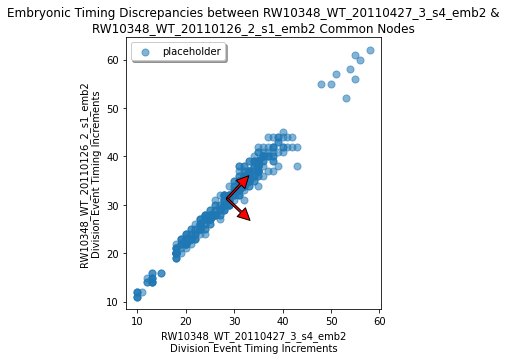

[[ 0.68755025  0.7261368 ]
 [ 0.7261368  -0.68755025]] [144.8604571    1.06126902] 
 1.0561217772595444


(None, 1.0561217772595444, 1.0561217772595444)

In [53]:
dict_PCA_img(refnameset,refdictset,10,2),dict_PCA(refnameset,refdictset,10,2),PCA_slope(refdictset[10],refdictset[2])

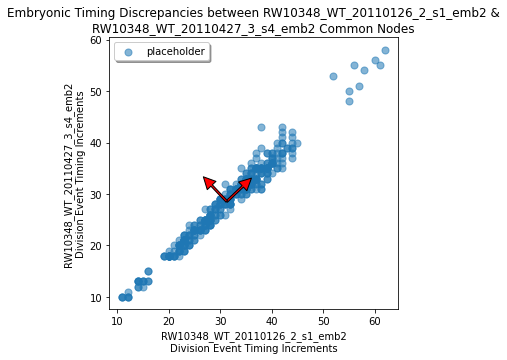

[[ 0.7261368   0.68755025]
 [-0.68755025  0.7261368 ]] [144.8604571    1.06126902] 
 0.9468605056083857


(None, 0.9468605056083857, 0.9468605056083857)

In [54]:
dict_PCA_img(refnameset,refdictset,2,10),dict_PCA(refnameset,refdictset,2,10),PCA_slope(refdictset[2],refdictset[10])

In [156]:
b_mat = [];PCA_mat = [];cosine_mat = []
for n in range(0,len(refdictset)):
    b_row = [];PCA_row = [];cosine_row = []
    for m in range(0,len(refdictset)):
        b_row.append(branch_distance(refdictset[n],refdictset[m]))
        PCA_row.append(PCA_slope(refdictset[n],refdictset[m]))
        cosine_row.append(cosine_pseudodistance(refdictset[n],refdictset[m]))
    b_mat.append(b_row)
    PCA_mat.append(PCA_row)
    cosine_mat.append(cosine_row)
b_mat_WT = np.mat(b_mat);PCA_mat = np.mat(PCA_mat);cosine_mat = np.mat(cosine_mat)

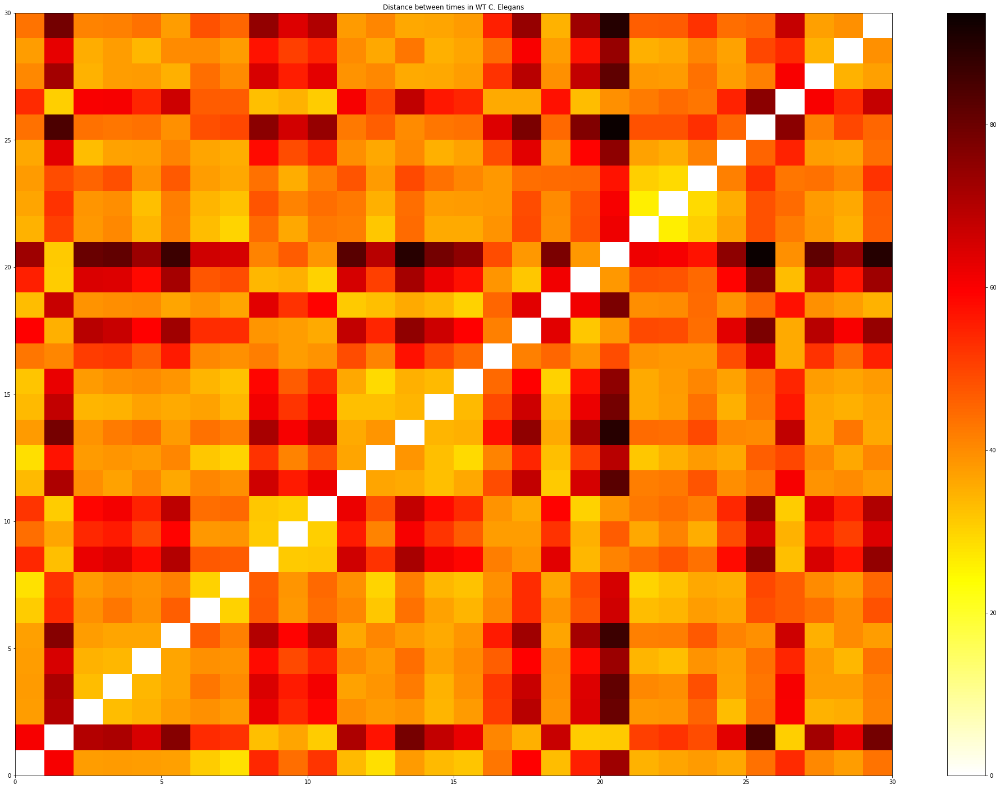

In [157]:
plot_2_examples(['hot_r'],b_mat_WT  )

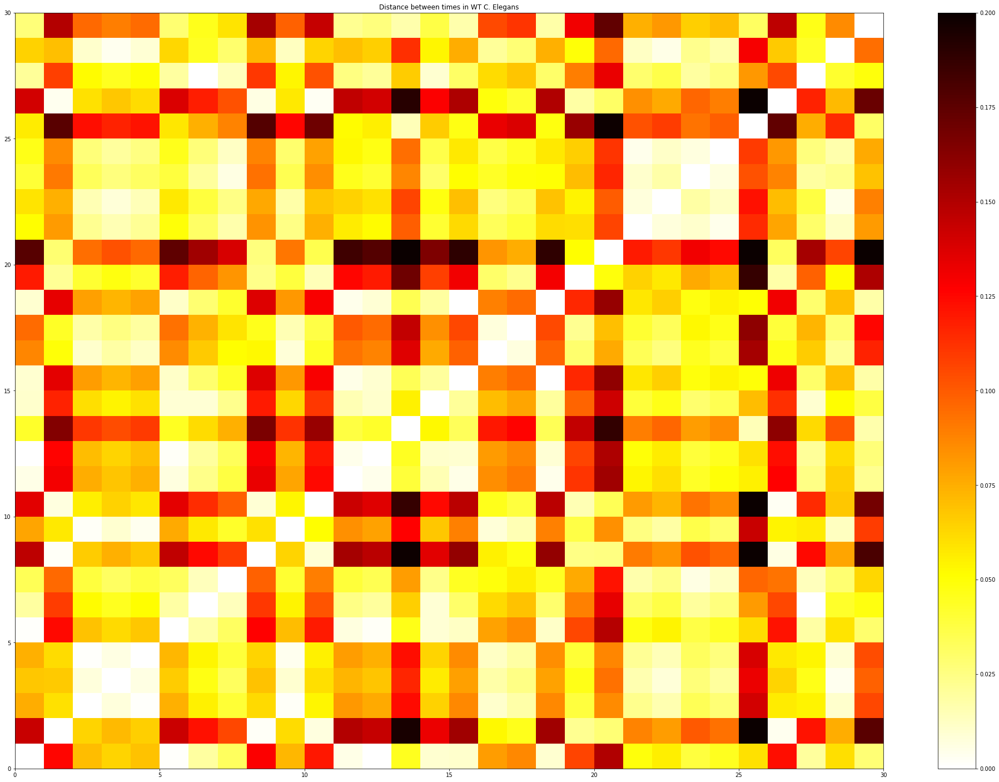

In [319]:
plot_2_examples(['hot_r'],np.abs(PCA_mat-1))

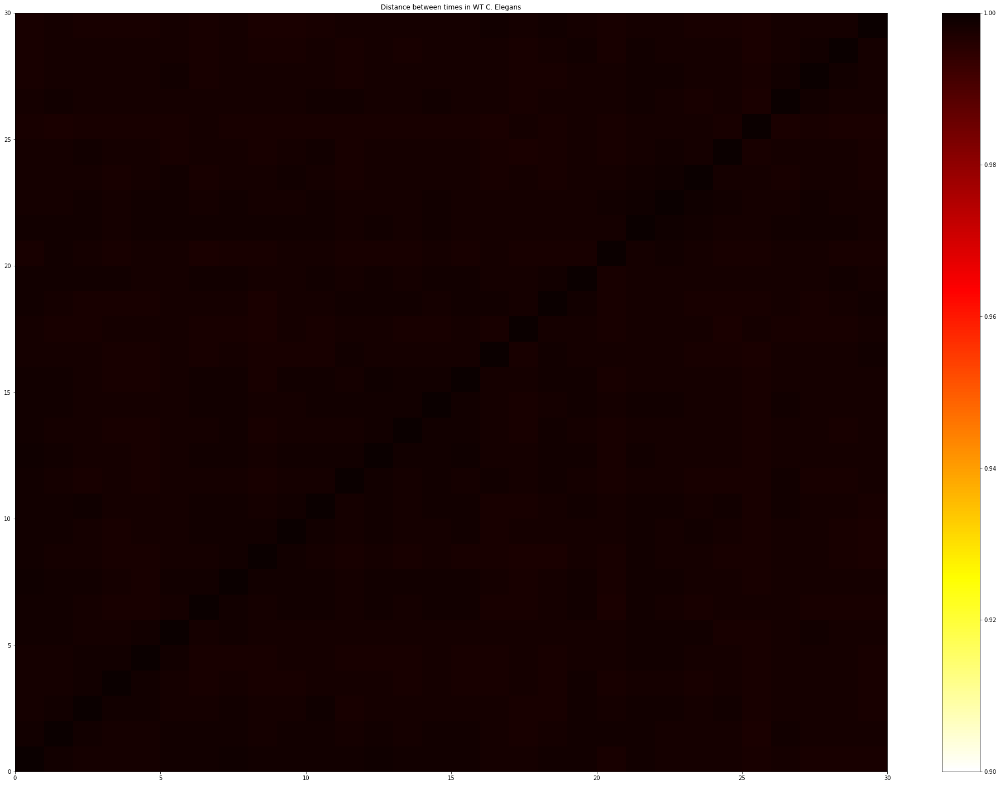

In [320]:
plot_2_examples(['hot_r'], cosine_mat)

/tmp/ipykernel_468466/814566297.py:1: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  Z = linkage(np.mat(b_mat), 'average')


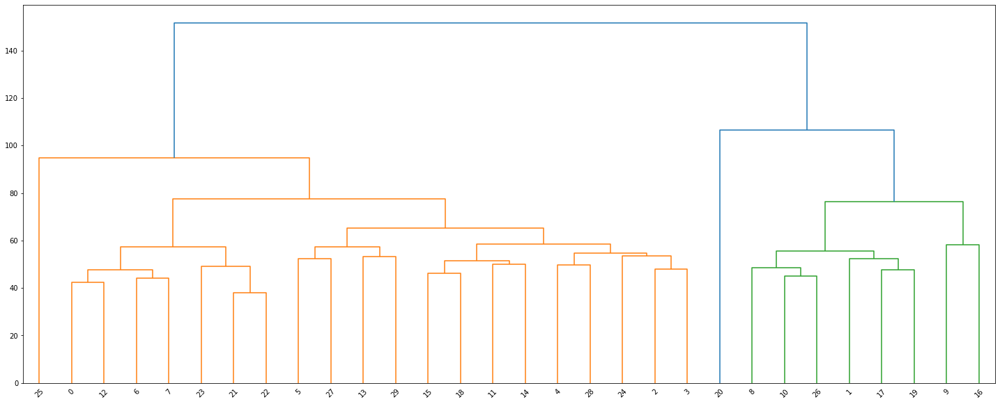

In [321]:
Z = linkage(np.mat(b_mat), 'average')
fig = plt.figure(figsize=(25, 10))
dn = dendrogram(Z)
b_mat_cluster = fcluster(Z, t=2, criterion='maxclust') 

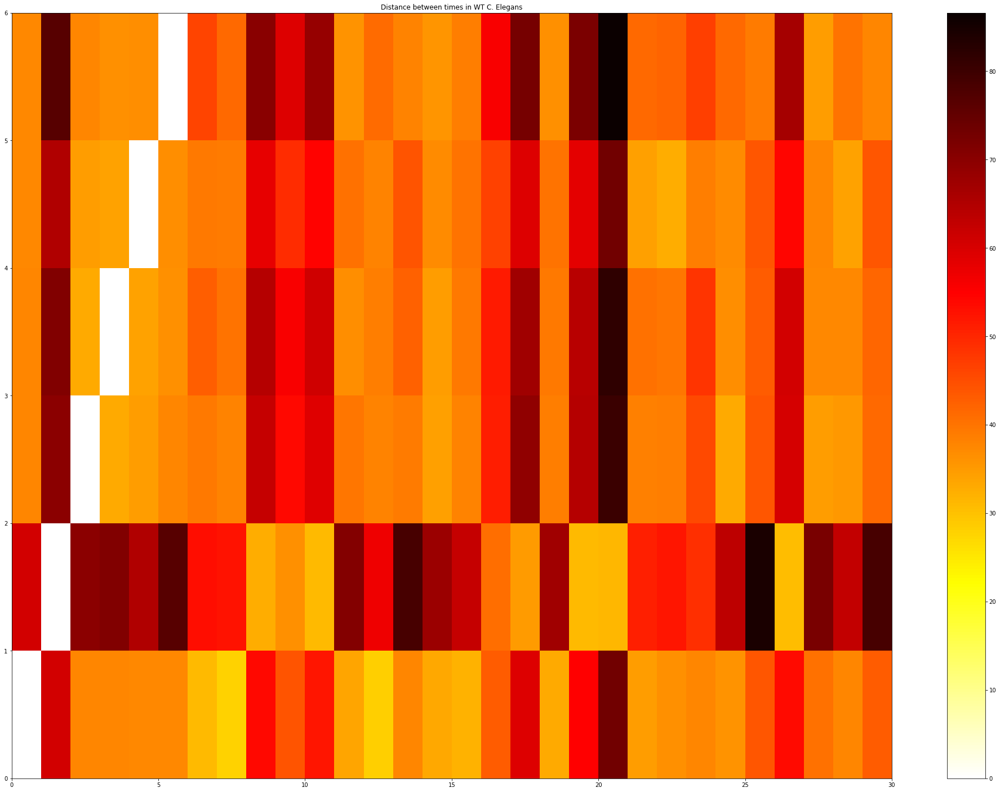

In [324]:
plot_2_examples(['hot_r'],b_mat)

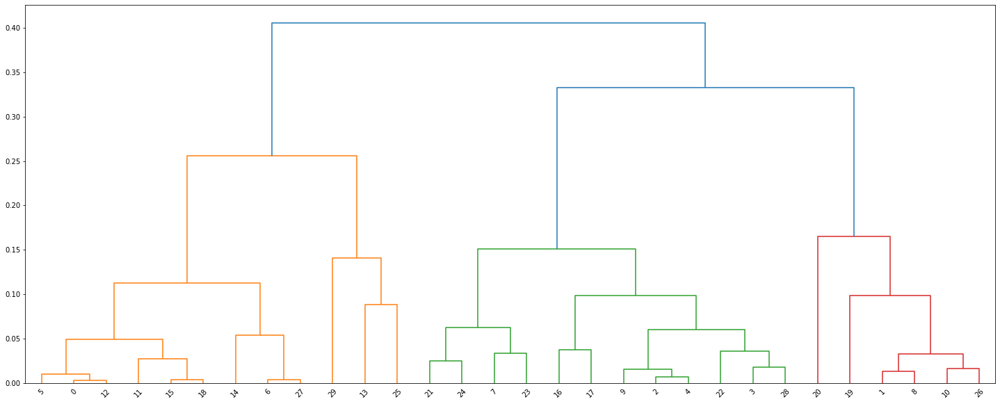

In [25]:
Z = linkage(np.abs(PCA_mat-1).T, 'average')
fig = plt.figure(figsize=(25, 10))
dn = dendrogram(Z)
PCA_mat_cluster = fcluster(Z, t=2, criterion='maxclust') 

In [26]:
np.abs(PCA_mat-1).sum(axis=0).argmin(),b_mat.sum(axis=0).argmin()

(21, 21)

In [27]:
intscaledrefdictset = [];floatscaledrefdictset = []
for n in range(0,len(refdictset)):
    new_dict_int = dict()
    new_dict_float = dict()
    slope = dict_PCA(refnameset,refdictset,21,n)
    #print(dict_PCA(refnameset,refdictset,21,n))
    for m in refdictset[n]:
        #print(m,refdictset[n][m],refdictset[n][m]/slope)
        new_dict_int[m] = int(refdictset[n][m]/slope)+1
        new_dict_float[m] = refdictset[n][m]/slope
    intscaledrefdictset.append(new_dict_int);floatscaledrefdictset.append(new_dict_float)

In [28]:
medsc_b_mat = [];medsc_PCA_mat = [];medsc_cosine_mat = []
for n in range(0,len(refdictset)):
    b_row = [];PCA_row = [];cosine_row = []
    for m in range(0,len(refdictset)):
        b_row.append(branch_distance(intscaledrefdictset[n],intscaledrefdictset[m]))
        PCA_row.append(dict_PCA(refnameset,intscaledrefdictset,n,m))
        cosine_row.append(cosine_pseudodistance(intscaledrefdictset[n],intscaledrefdictset[m]))
    medsc_b_mat.append(b_row)
    medsc_PCA_mat.append(PCA_row)
    medsc_cosine_mat.append(cosine_row)
medsc_b_mat = np.mat(medsc_b_mat);medsc_PCA_mat = np.mat(medsc_PCA_mat);medsc_cosine_mat = np.mat(medsc_cosine_mat)

In [29]:
np.sum(b_mat),np.sum(medsc_b_mat)

(41081.49625408887, 36620.707899859124)

In [418]:
#plot_2_examples(["YlGnBu"],b_mat  );plot_2_examples(["YlGnBu"],medsc_b_mat)

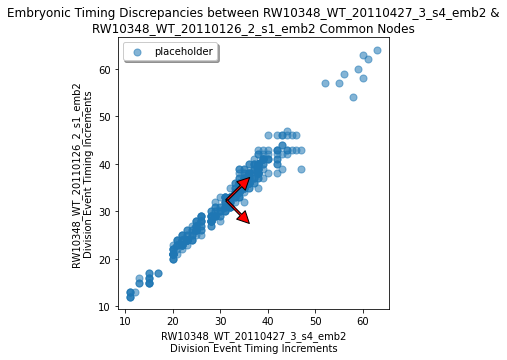

[[ 0.71119406  0.70299574]
 [ 0.70299574 -0.71119406]] [158.23440658   1.27591083] 
 0.9884724473087759


(None, 1.0561217772595444)

In [31]:
dict_PCA_img(refnameset,intscaledrefdictset,10,2),dict_PCA(refnameset,refdictset,10,2)

In [33]:
def node_comparison_trimmer(dict0,root_node):
    dict1 = dict(dict0)
    tip = dict()
    if root_node == 'EMS':
        root_node = 'Q'
        for n in [x for x in dict1 if re.search('E', x) or re.search('MS', x)]:
            if n[0] == 'E':
                dict1['Qp'+n[1:]] = dict1[n]
            elif n == 'MS' : dict1['Qp'] = dict1['MS']
            else:
                dict1['Qa'+n[2:]] = dict1[n]
    elif root_node == 'P2':
        root_node = 'Q'
        try:
            dict1['P3'] = dict1['Ql']
        except:
            pass
        for n in [x for x in dict1 if re.search('C', x) or re.search('D', x)]:
            if n[0] == 'C':
                dict1['Qr'+n[1:]] = dict1[n]
            else:
                dict1['Qrr'+n[1:]] = dict1[n]
    elif root_node == 'P3':
        root_node = 'Q'
        try:
            dict1['P4'] = dict1['Ql']
        except:
            pass
        for n in [x for x in dict1 if re.search('D', x)]:
            dict1['Qr'+n[1:]] = dict1[n]
    for n in [x for x in dict1 if re.search(root_node, x)]: 
        m = n.replace('r', "p").replace('v', "p")
        m = m.replace('d', "a").replace('l', "a")
        m = m[len(root_node):]
        tip[m] = dict1[n]
    return tip

#TROUBLESHOOT

In [34]:
'''for n in root_cells:
    for m in range(0,30):
        try:
            refdictset[m][n]
        except:
            print(m,n)'''
#This script finds inconsistencies within the presence of various cells in the given embryos 
#if run, it shows the founder cells that do not exist in the reference nodes
#none of the 30 embryos have nodes AB, nodes P1 and P4 are inconsistently present

'for n in root_cells:\n    for m in range(0,30):\n        try:\n            refdictset[m][n]\n        except:\n            print(m,n)'

In [24]:
root_cells_comp = [ 'ABa', 'ABp', 'ABal', 'ABar', 'ABpl', 'ABpr', 'ABala', 'ABalp', 'ABara', 'ABarp', 'ABpla', 'ABplp', 'ABpra', 'ABprp', 'EMS', 'P2', 'MS', 'E', 'C', 'P3', 'D', ]
inlier_ref = [ 0,  2,  3,  4,  5,  6,  7, 11, 12, 13, 14, 15, 16, 18, 21, 22, 23, 24, 25, 27, 28, 29]

def self_comp(imp_mat):
    imp_mat = np.mat(imp_mat)
    imp_mat = np.tril(np.array(imp_mat)).flatten()
    imp_mat = imp_mat[np.where(imp_mat != 0.0)]
    return (imp_mat)

In [262]:
'''
b_mat = [];cos_mat = [];jac_mat = [];PCA_mat = []
for n in root_cells_comp:
    for m in inlier_ref:
        branches = []; cos_row = []; jac_row = []; PCA_row = []
        nim = node_comparison_trimmer(fulldictset[m],n)
        for a in root_cells_comp:
            for b in inlier_ref:
                ab = node_comparison_trimmer(fulldictset[b],a)
                cos_row.append(cosine_pseudodistance(nim,ab))
                branches.append(branch_distance(nim,ab))
                jac_row.append(jaccard_distance(nim,ab))
                PCA_row.append(PCA_slope(nim,ab))
        b_mat.append(branches)
        cos_mat.append(cos_row)
        jac_mat.append(jac_row)
        PCA_mat.append(PCA_row)
cos_mat = np.mat(cos_mat)
b_mat = np.mat(b_mat)     
jac_mat = np.mat(jac_mat)
PCA_mat = np.mat(PCA_mat)'''
#plot_2_examples(['viridis'],b_mat)
#plot_2_examples(['hsv'],b_mat)

'\nb_mat = [];cos_mat = [];jac_mat = [];PCA_mat = []\nfor n in root_cells_comp:\n    for m in inlier_ref:\n        branches = []; cos_row = []; jac_row = []; PCA_row = []\n        nim = node_comparison_trimmer(fulldictset[m],n)\n        for a in root_cells_comp:\n            for b in inlier_ref:\n                ab = node_comparison_trimmer(fulldictset[b],a)\n                cos_row.append(cosine_pseudodistance(nim,ab))\n                branches.append(branch_distance(nim,ab))\n                jac_row.append(jaccard_distance(nim,ab))\n                PCA_row.append(PCA_slope(nim,ab))\n        b_mat.append(branches)\n        cos_mat.append(cos_row)\n        jac_mat.append(jac_row)\n        PCA_mat.append(PCA_row)\ncos_mat = np.mat(cos_mat)\nb_mat = np.mat(b_mat)     \njac_mat = np.mat(jac_mat)\nPCA_mat = np.mat(PCA_mat)'

In [419]:
#plot_2_examples(['hsv'],b_mat)
#root_cells_comp

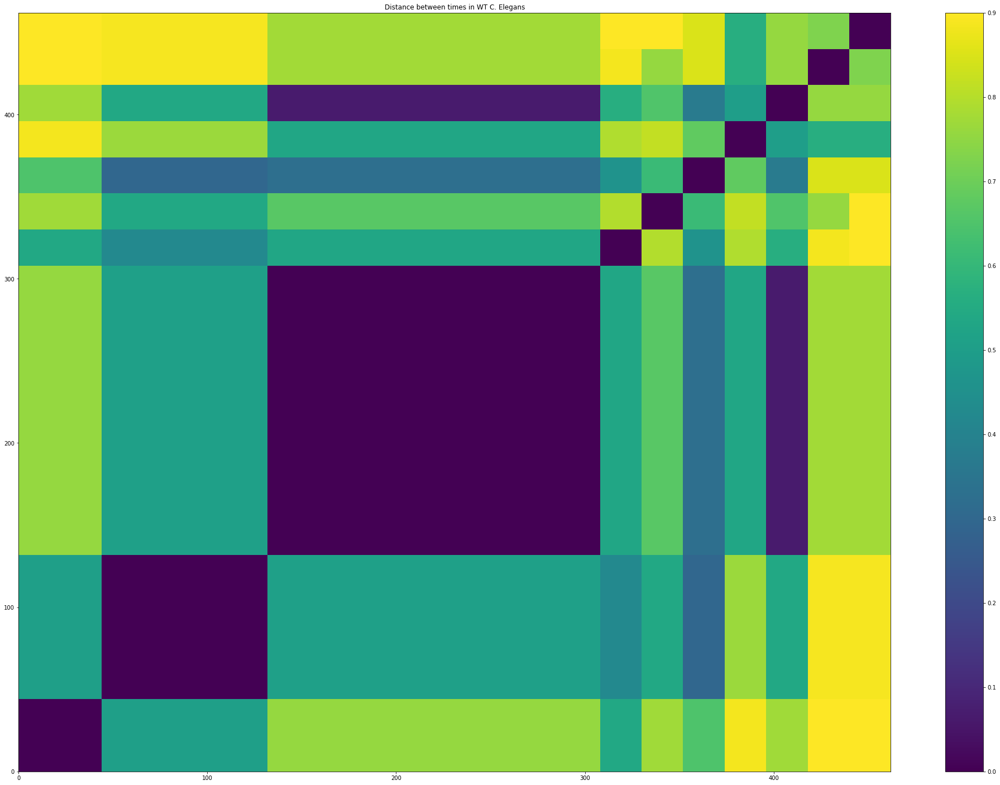

In [70]:
plot_2_examples(['viridis'],jac_mat)

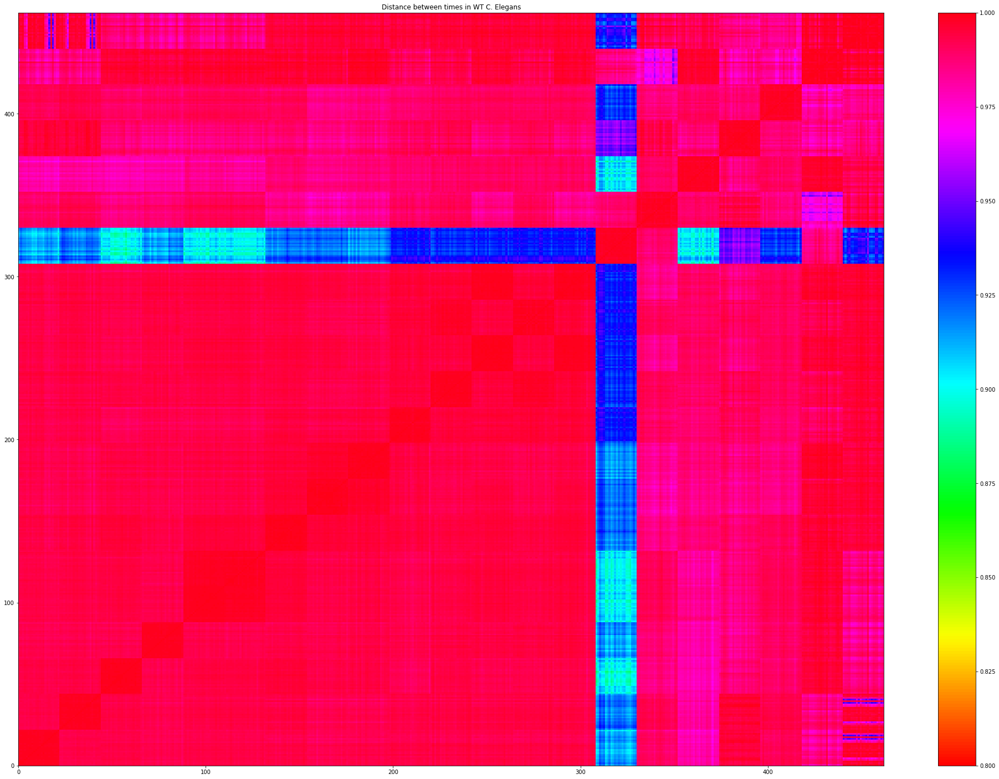

In [68]:
plot_2_examples(['hsv'],cos_mat)

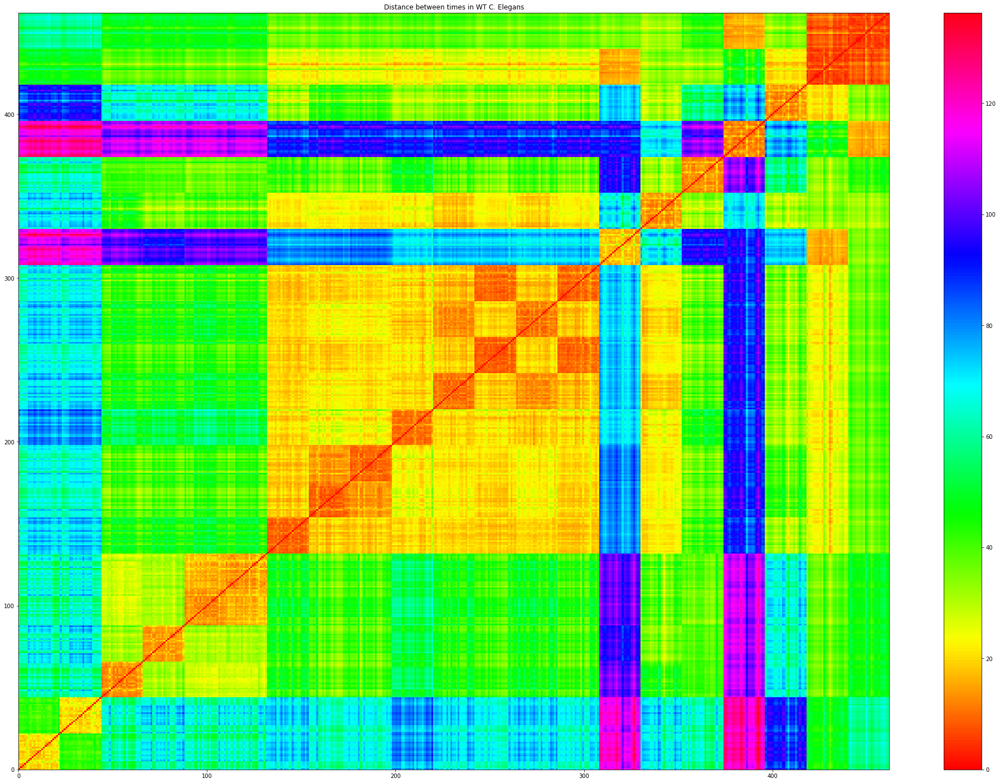

In [359]:
#plot_2_examples(['hsv'],b_mat)

In [362]:
scale = len(inlier_ref)
scale

22

In [35]:
b_mat = np.mat(b_mat); np.seterr(divide='ignore', invalid='ignore')
from scipy.stats import ttest_ind, ttest_ind_from_stats
from scipy.special import stdtr

In [123]:
def novel_two_sample_permutation_test(list1,list2,its):
    ref_list = sorted([list1,list2], key = len)
    list1 = ref_list[0];list2 = ref_list[1]
    len1 = len(list1);len2 = len(list2)
    list1,list2 = np.array(list1),np.array(list2)
    reference_mean = np.mean(list1) - np.mean(list2)
    hist_list = []
    for n in range(0,its):
        pop15 = random.sample(range(0, len2), len1)
        full_list = np.concatenate((list1,list2[pop15]), axis=None)
        pop1 = random.sample(range(0, len(full_list)), len1);
        pop2 = random.sample(range(0, len(full_list)), len1)
        resamp_mean = np.mean(full_list[pop1]) - np.mean(full_list[pop2])
        hist_list.append(resamp_mean)
    #plt.hist(hist_list)
    hist_list = np.array(hist_list)
    if reference_mean < 0:
        p = np.sum(hist_list <= reference_mean)/its
    else:
        p = np.sum(hist_list >= reference_mean)/its
    return p
    #Its one sided because the distances between ingroup members is always going to be smaller.
    #rewrite to check for making sure the differences is always one sided such that RNAi distance mean is 
    #larger than the ingroup distance mean
        

In [40]:
b_mat = np.mat(b_mat) 
n = 13;m = 11
scale = len(inlier_ref)
go = self_comp(np.mat(b_mat[n*scale:(n+1)*scale,n*scale:(n+1)*scale])).tolist()
go2 = np.mat(b_mat[n*scale:(n+1)*scale,m*scale:(m+1)*scale]).flatten()[0]
go2 = go2[go2 != 0]
go2 = go2.tolist()[0]
print(novel_two_sample_permutation_test(go2,go,10000))
t,p = ttest_ind(go, go2, equal_var=False)
print(t,p)
t,p = stats.brunnermunzel(go, go2)
print(t,p)

0.1851
0.7229288756214408 0.47016433321784135
-0.02379872972860727 0.9810260801261453


In [48]:
scale = len(inlier_ref);b_mat = np.mat(b_mat)
resample_mat = [];ttest_mat = [];bm_mat = []
for n in range(0,scale-1):
    resample_row = [];ttest_row = [];bm_row = []
    nn = self_comp(np.mat(b_mat[n*scale:(n+1)*scale,n*scale:(n+1)*scale])).tolist()
    for m in range(0,scale-1):
        go2 = np.mat(b_mat[n*scale:(n+1)*scale,m*scale:(m+1)*scale]).flatten()[0]
        go2 = go2[go2 != 0]
        mm = go2.tolist()[0]
        ntsp = novel_two_sample_permutation_test(nn,mm,10000)
        if ntsp > 0.01:
            if n != m:
                print('WT/WT branch',root_cells_comp[n],'WT/WT branch',root_cells_comp[n],root_cells_comp[m])
            #print(ntsp)
        resample_row.append(ntsp)
        t,p = ttest_ind(nn,mm, equal_var=False)
        ttest_row.append(p)
        t2,p2 = stats.brunnermunzel(nn,mm)
        bm_row.append(p2)
    resample_mat.append(resample_row)
    ttest_mat.append(ttest_row)
    bm_mat.append(bm_row)

resample_mat = np.mat(resample_mat);ttest_mat = np.mat(ttest_mat);bm_mat = np.mat(bm_mat)
bm_mat = np.nan_to_num(bm_mat)
        #print(n,m,nn[0:2],mm[0:2])

WT/WT branch ABprp WT/WT branch ABprp ABplp


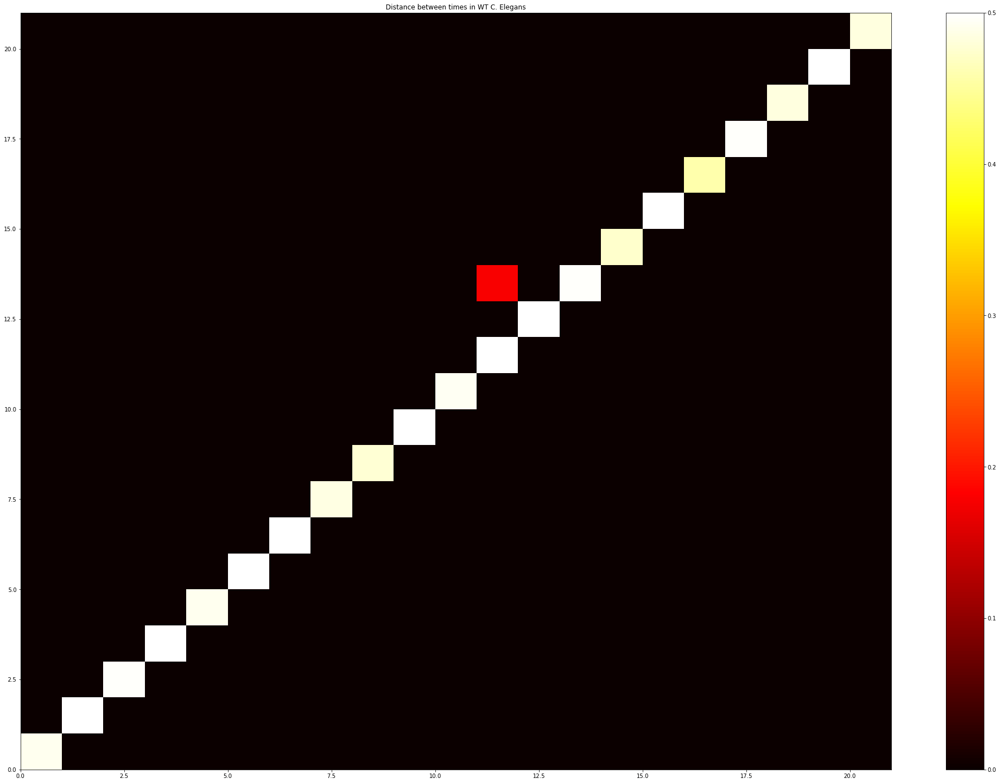

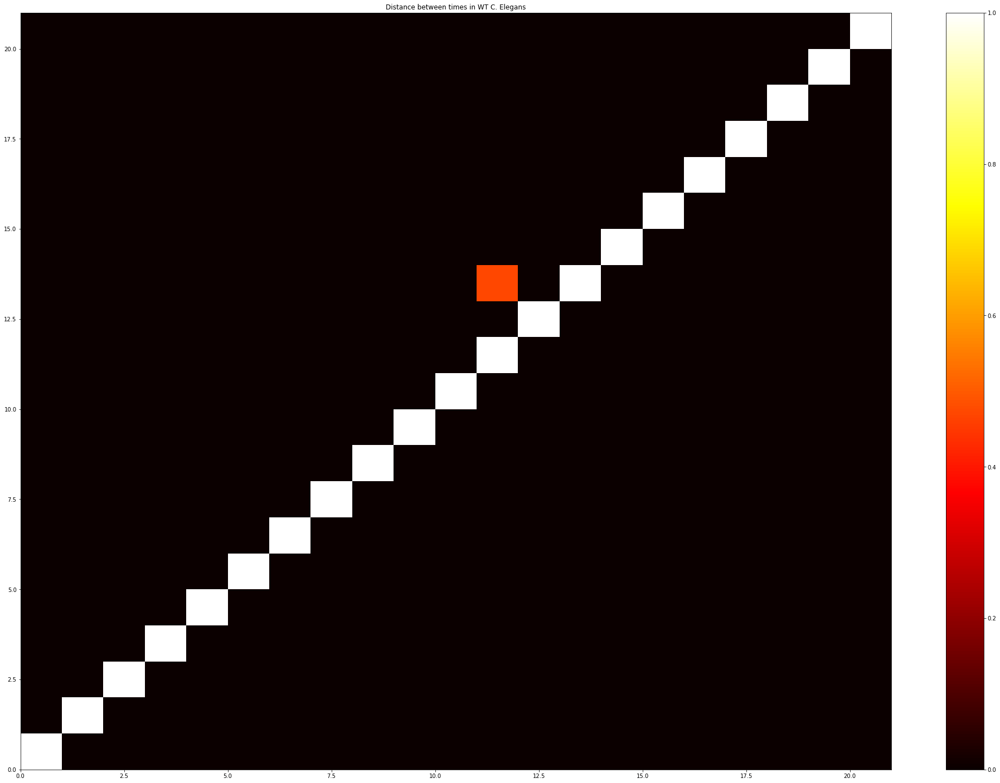

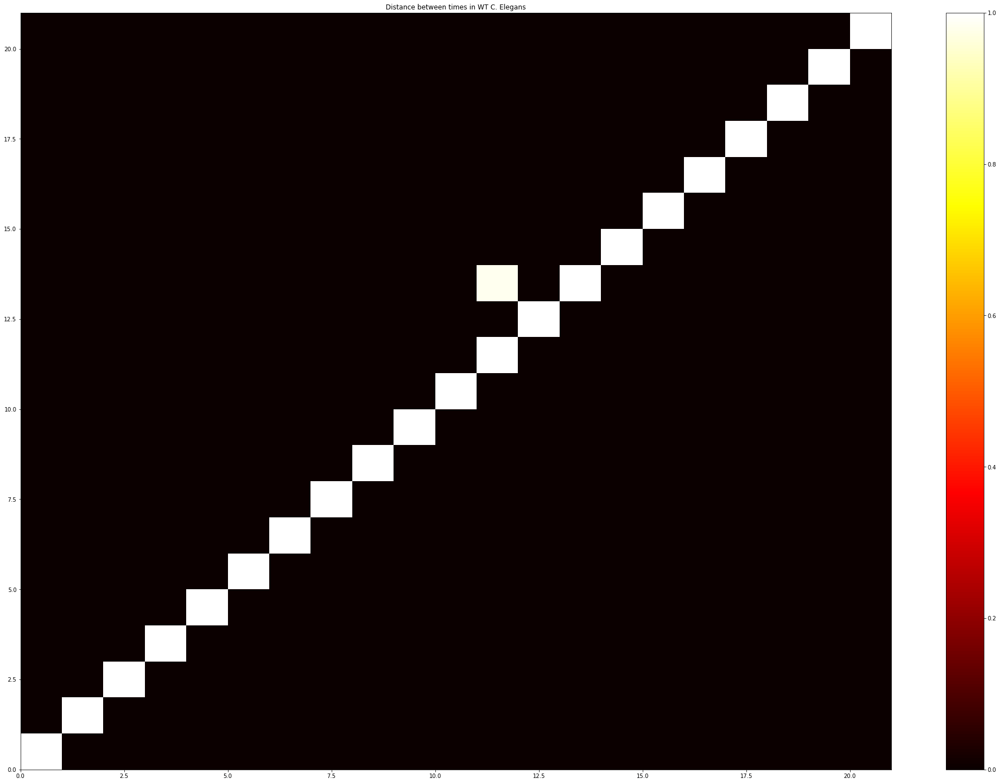

In [49]:
plot_2_examples(['hot'],resample_mat);plot_2_examples(['hot'],ttest_mat);plot_2_examples(['hot'],bm_mat)

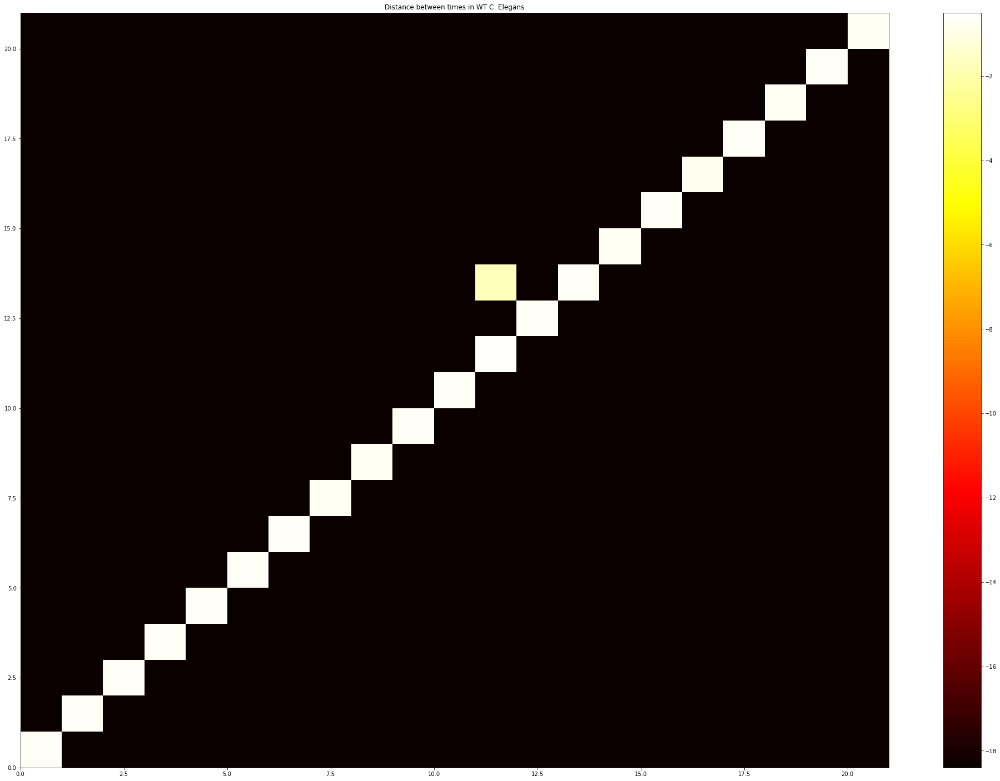

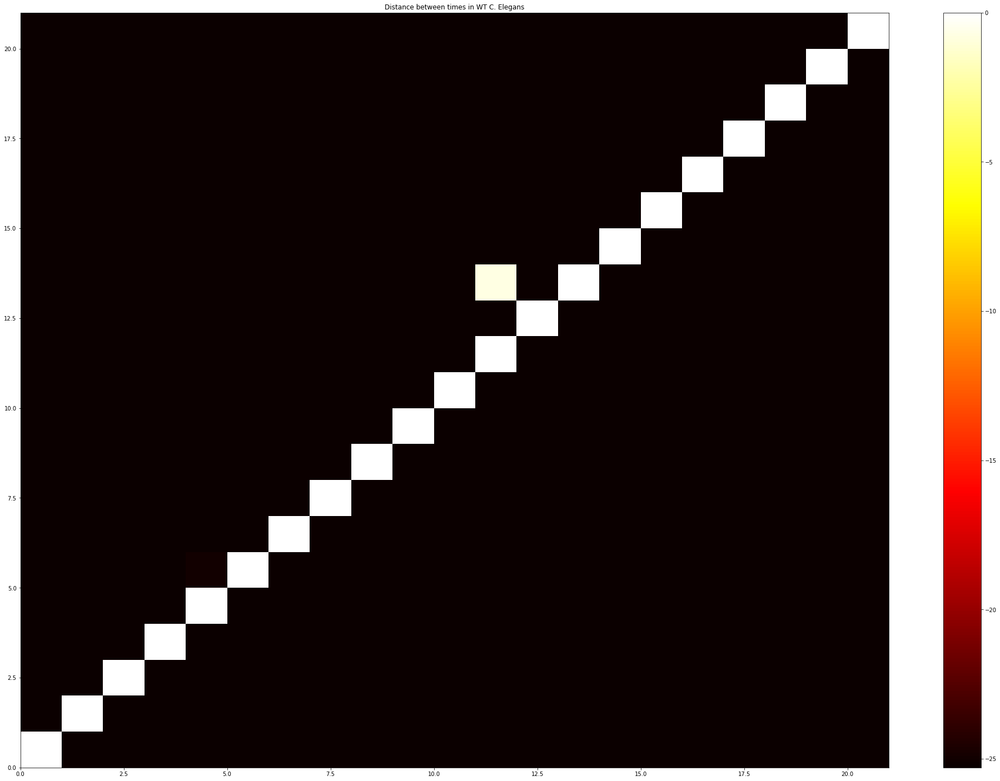

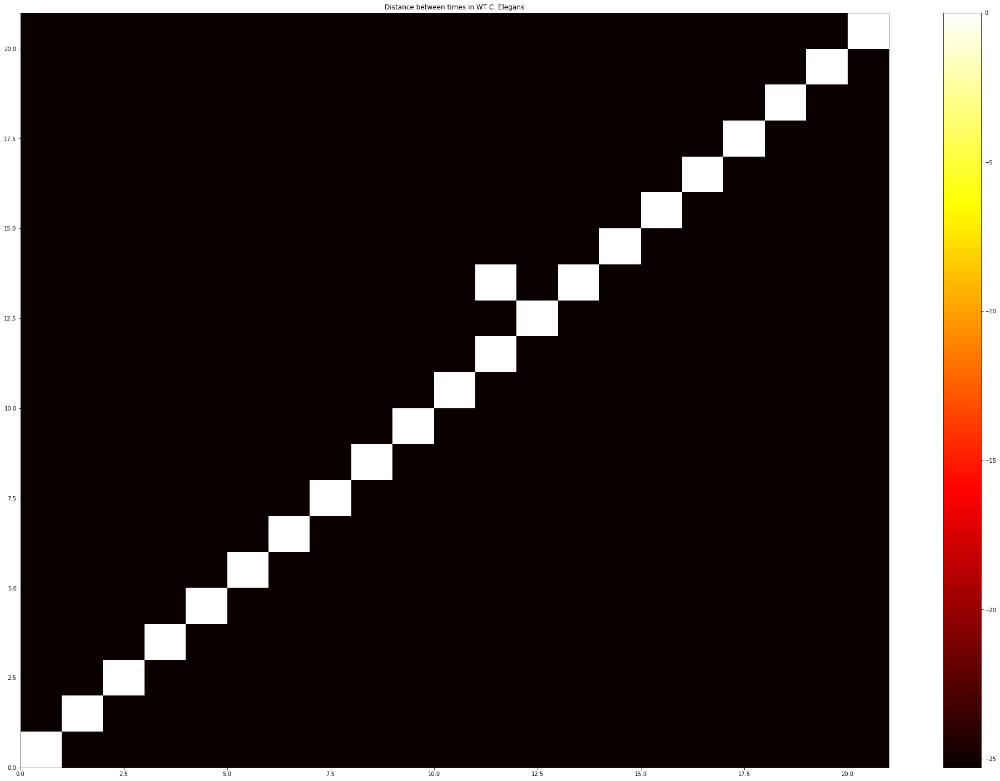

In [50]:
plot_2_examples(['hot'],np.log(resample_mat+0.00000001));plot_2_examples(['hot'],np.log(ttest_mat+0.00000000001));plot_2_examples(['hot'],np.log(bm_mat+0.00000000001))

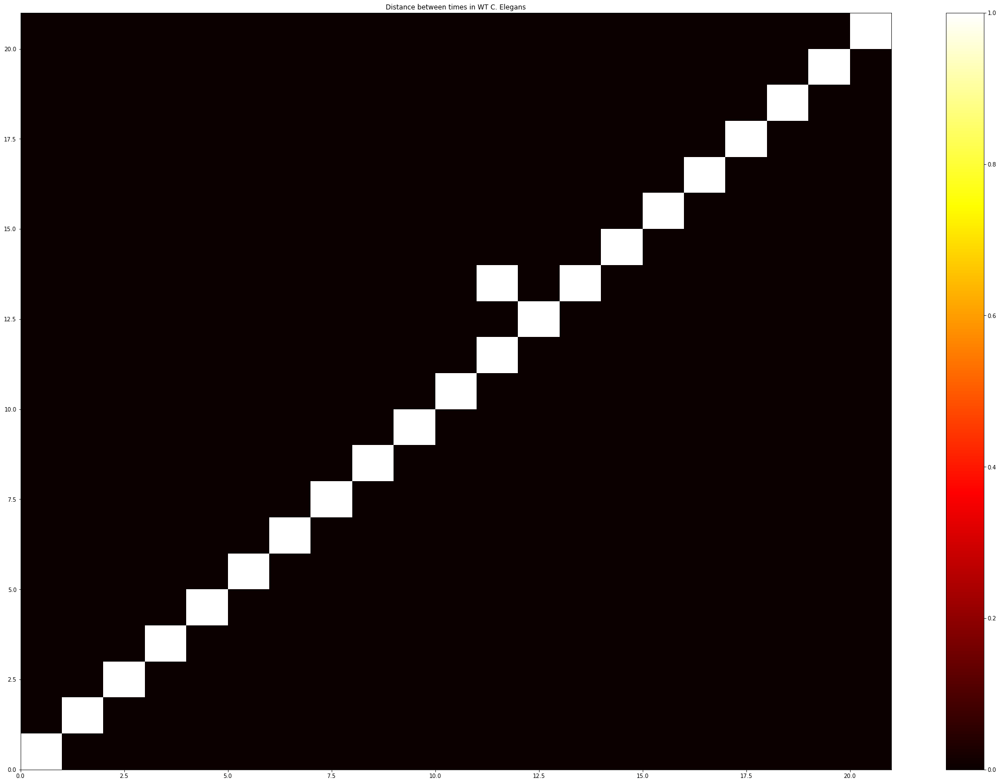

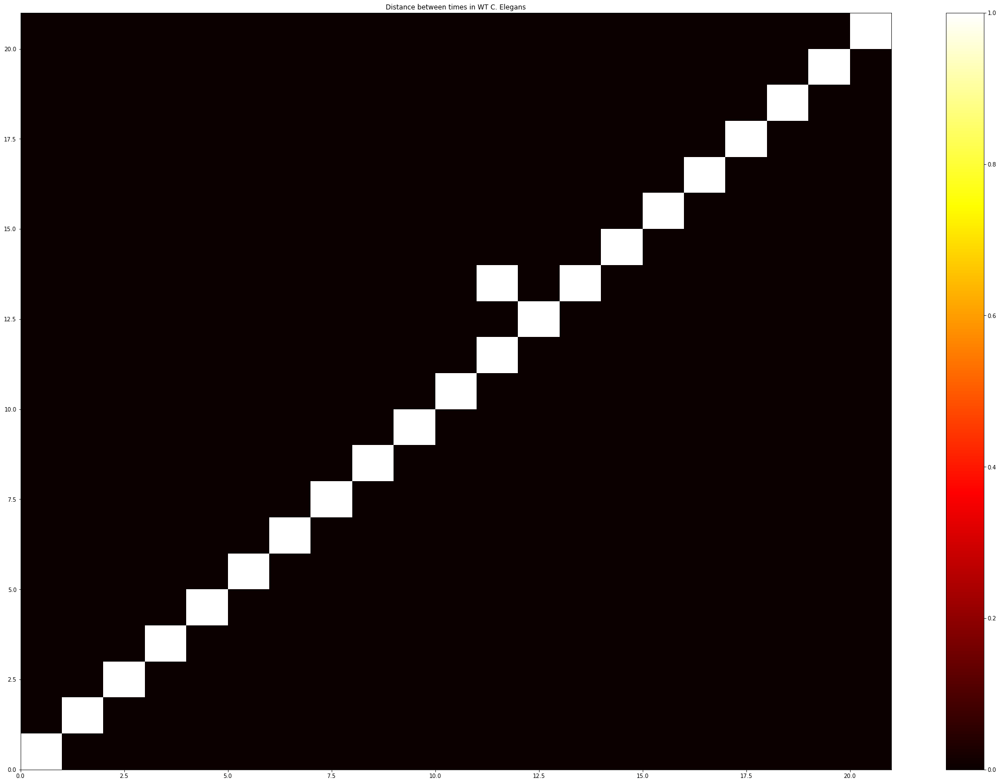

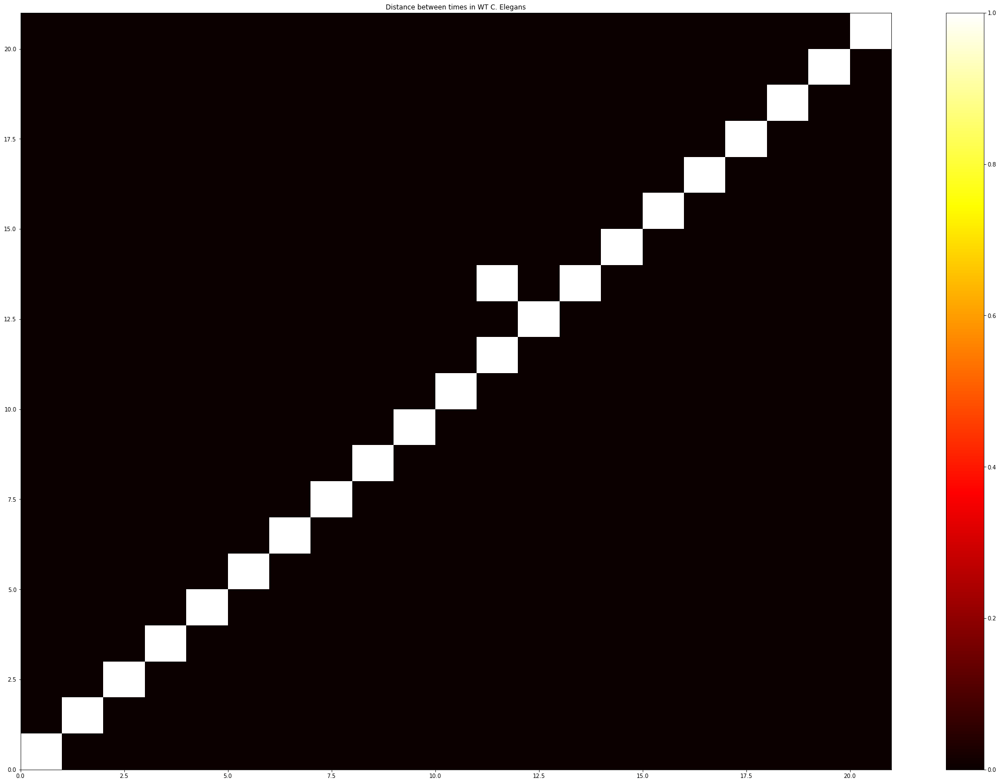

In [61]:
bonferoni_correction_alpha = 0.05
bonferoni_correction_constant = bonferoni_correction_alpha / float(ttest_mat.size)
plot_2_examples(['hot'],resample_mat > bonferoni_correction_constant);plot_2_examples(['hot'],ttest_mat > bonferoni_correction_constant);plot_2_examples(['hot'],bm_mat > bonferoni_correction_constant)

In [1577]:
#These 3 graphs say that WT ABprp against RNAI 
print(ttest_mat[13,11])
root_cells_comp[11],root_cells_comp[13]

0.47016433321784135


('ABplp', 'ABprp')

In [1578]:
from scipy.stats import ttest_ind, ttest_ind_from_stats
from scipy.special import stdtr

In [1579]:
#plot_2_examples(["YlGnBu"],p_val_mat)
print(root_cells_comp)


['ABa', 'ABp', 'ABal', 'ABar', 'ABpl', 'ABpr', 'ABala', 'ABalp', 'ABara', 'ABarp', 'ABpla', 'ABplp', 'ABpra', 'ABprp', 'EMS', 'P2', 'MS', 'E', 'C', 'P3', 'D']


In [204]:
b_mat = []
j_mat = []
t_mat = []
cos_mat = []
for n in range(0,len(nameset)):
    t_row = []
    j_row = []
    b_row = []
    cos_row = []
    for m in range(0,len(refnameset)):
        #go = cleaner(refdictset,refglobaldictset,m,match_links,dictset,globaldictset,n)
        go = refdictset[m]
        j_row.append(jaccard_distance(go,dictset[n]))
        t_row.append(tree_edit_distance(go,dictset[n]))
        b_row.append(branch_distance(go,dictset[n]))
        cos_row.append(cosine_pseudodistance(go,dictset[n]))
    j_mat.append(j_row)
    t_mat.append(t_row)
    b_mat.append(b_row)
    cos_mat.append(cos_row)
    #if n % 20 == 0: print(n/len(nameset))
j_mat = np.mat(j_mat)
t_mat = np.mat(t_mat)
b_mat = np.mat(b_mat)
cos_mat = np.mat(cos_mat)
#plot_2_examples(['hot_r'],np.mat(t_mat))
#plot_2_examples(['hot_r'],np.mat(b_mat))

In [164]:
RNAi_size_assignments = dict()
RNAi_name_array = []
for n in range(0,len(fullnameset)):
    pad = fullnameset[n].split('/')[-1][:-14]
    #print(pad,n)
    RNAi_name_array.append(pad)
    if 'REFERENCE' in pad:
        if n in inlier_ref:
            pad = 'inlierWT'
        else: 
            pad = 'outlierWT'
    try:
        z = RNAi_size_assignments[pad]
        z.append(n)
    except:
        z = list()
        z.append(n)
        RNAi_size_assignments[pad] = z
        
RNAi_name_array = np.array(RNAi_name_array)
#RNAi_size_assignments['inlierWT'],RNAi_size_assignments['outlierWT']
RNAi_name_array[RNAi_size_assignments['inlierWT']] = 'inlierWT'
RNAi_name_array[RNAi_size_assignments['outlierWT']] = 'outlierWT'



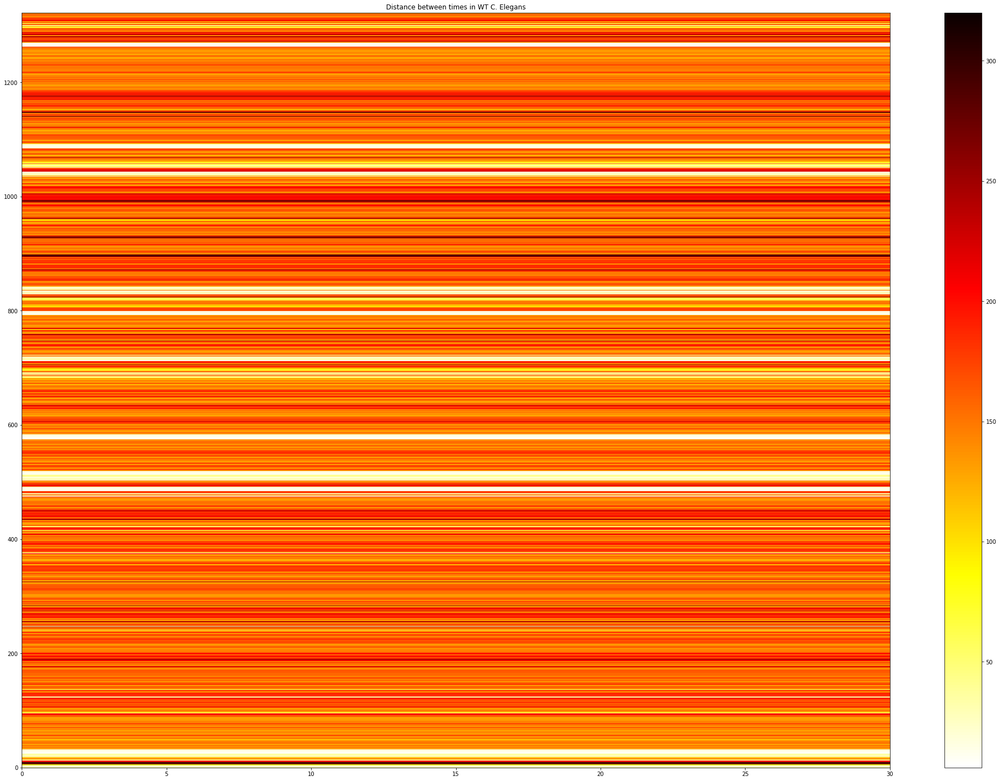

In [165]:
plot_2_examples(['hot_r'],np.mat(t_mat))

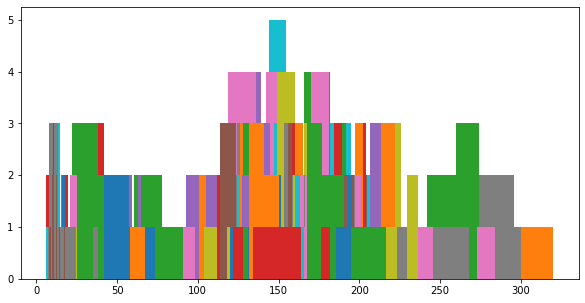

In [116]:
RNAi_WT_tree_distance_list = []
tree_full = np.array([])
#jaccard_full = np.concatenate((jaccard_full,comparisons), axis=None)
for n in list(RNAi_size_assignments)[2:]:
    tree_groups = t_mat[np.array(RNAi_size_assignments[n])-30,0].flatten()
    tree_groups = tree_groups.tolist()[0]
    RNAi_WT_tree_distance_list.append(tree_groups)
    tree_full = np.concatenate((tree_full,np.array(tree_groups)[:-6]), axis=None)
    plt.hist(tree_groups)

(array([19.,  5.,  3.,  1., 23., 41., 32.,  5.,  2.,  1.]),
 array([  6. ,  31.4,  56.8,  82.2, 107.6, 133. , 158.4, 183.8, 209.2,
        234.6, 260. ]),
 <BarContainer object of 10 artists>)

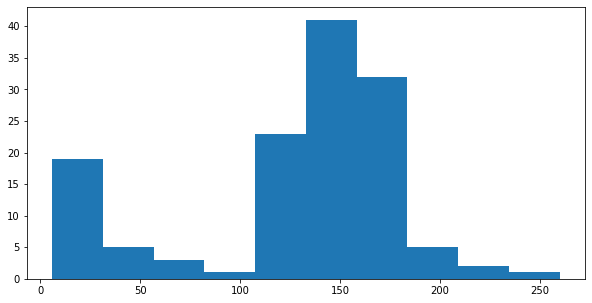

In [93]:
plt.hist(tree_full)

In [ ]:
#RNAi_WT_tree_significance_matrix
#RNAi_WT_tree_distance_list

In [143]:
RNAi_WT_tree_significance_matrix = []
for n in RNAi_WT_tree_distance_list:
    RNAi_WT_tree_significance_row = []
    for m in RNAi_WT_tree_distance_list:
        RNAi_WT_tree_significance_row.append(novel_two_sample_permutation_test(n,m,30))
    RNAi_WT_tree_significance_matrix.append(RNAi_WT_tree_significance_row)

RNAi_WT_tree_significance_matrix = np.mat(RNAi_WT_tree_significance_matrix)

#novel_two_sample_permutation_test(RNAi_WT_tree_distance_list[0],RNAi_WT_tree_distance_list[1],10000)


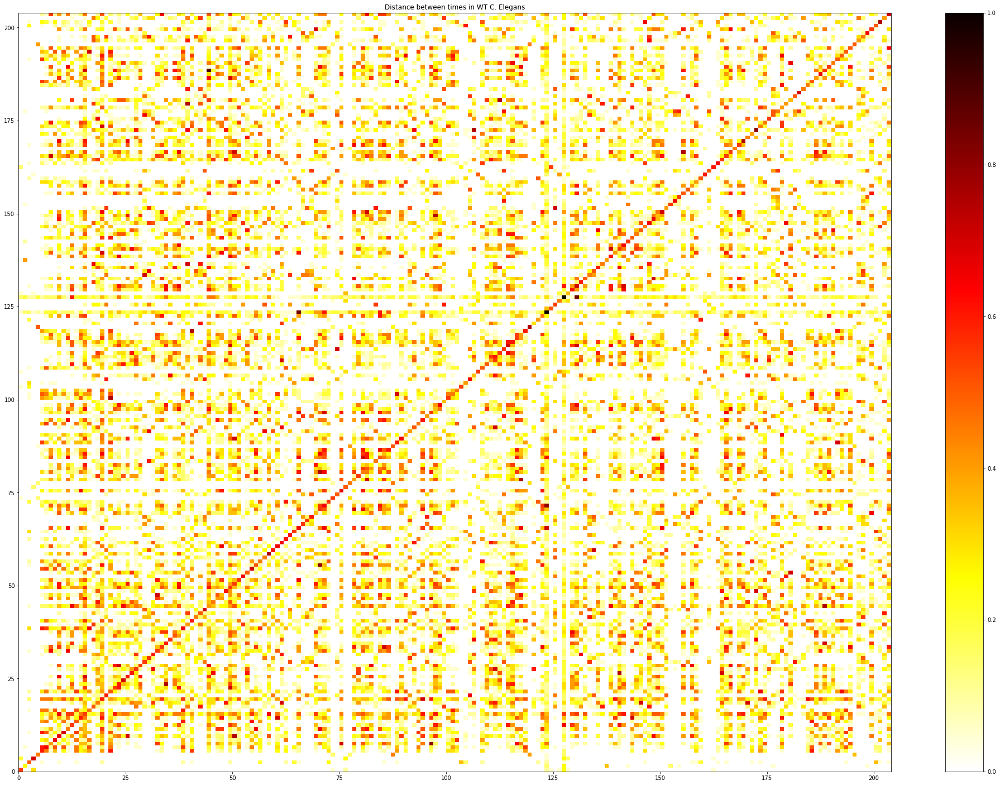

In [142]:
plot_2_examples(['hot_r'],RNAi_WT_tree_significance_matrix)

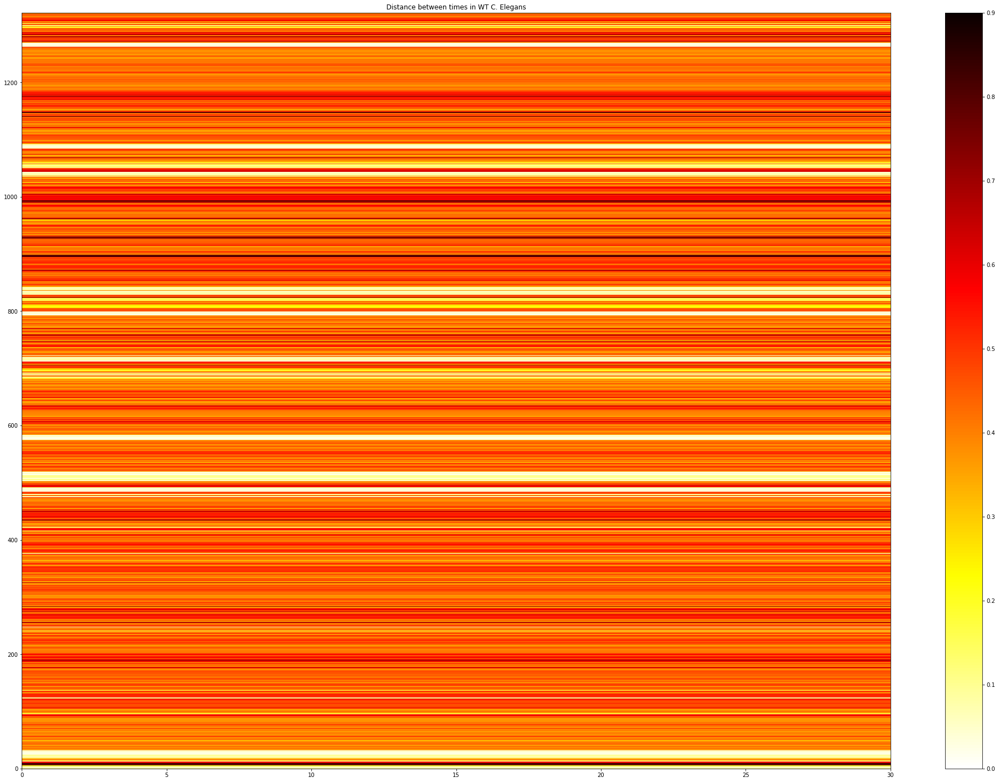

In [121]:
plot_2_examples(['hot_r'],np.mat(j_mat))

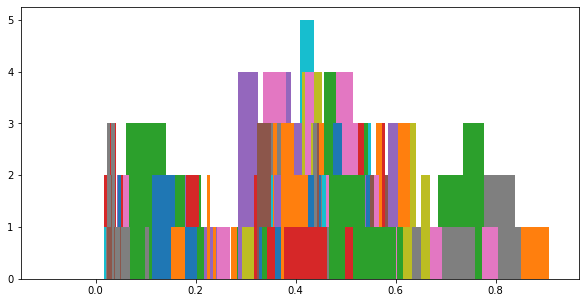

In [153]:
RNAi_WT_jaccard_distance_list = []
jaccard_full = np.array([])
#jaccard_full = np.concatenate((jaccard_full,comparisons), axis=None)
for n in list(RNAi_size_assignments)[2:]:
    jaccard_groups = j_mat[np.array(RNAi_size_assignments[n])-30,0].flatten()
    jaccard_groups = jaccard_groups.tolist()[0]
    RNAi_WT_jaccard_distance_list.append(jaccard_groups)
    jaccard_full = np.concatenate((jaccard_full,np.array(jaccard_groups)[:-6]), axis=None)
    plt.hist(jaccard_groups)

(array([20.,  5.,  2.,  1., 24., 42., 30.,  5.,  2.,  1.]),
 array([0.01671309, 0.08869617, 0.16067926, 0.23266234, 0.30464542,
        0.3766285 , 0.44861158, 0.52059466, 0.59257775, 0.66456083,
        0.73654391]),
 <BarContainer object of 10 artists>)

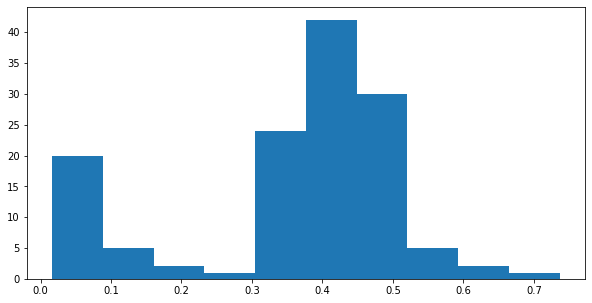

In [154]:
plt.hist(jaccard_full)

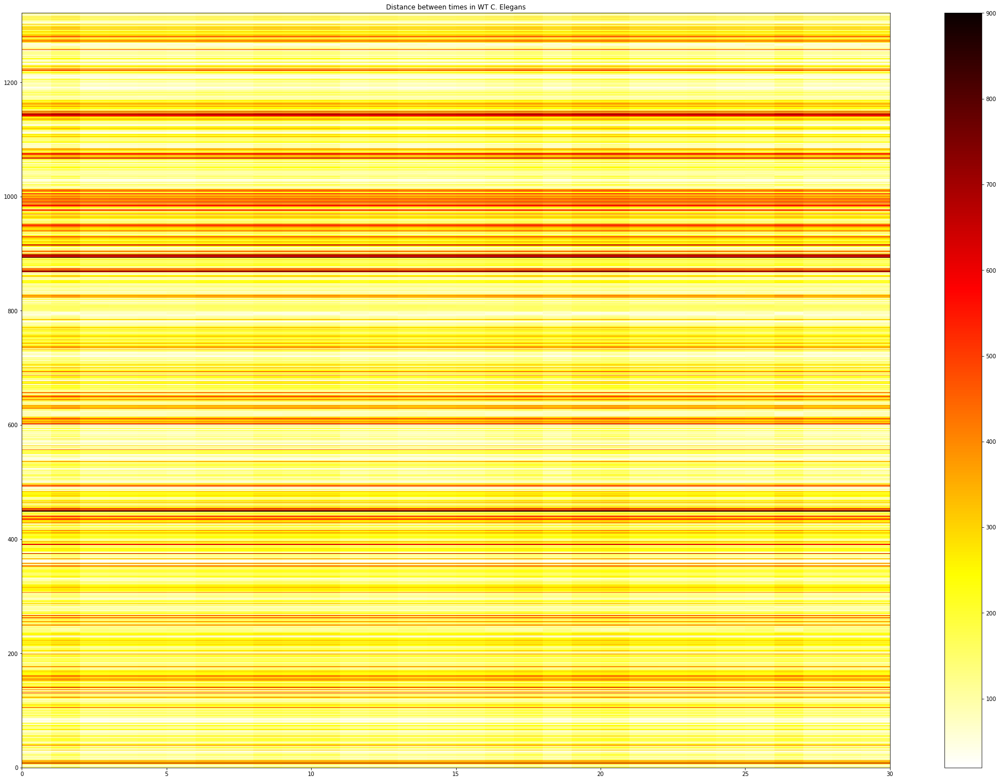

In [166]:
plot_2_examples(['hot_r'],np.mat(b_mat))

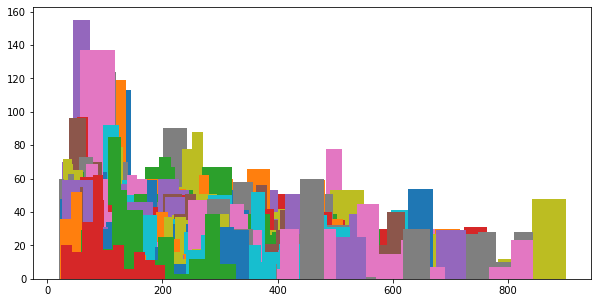

In [193]:
branch_full = np.array([])
#jaccard_full = np.concatenate((jaccard_full,comparisons), axis=None)
for n in list(RNAi_size_assignments)[2:]:
    #print(n)
    #print(n,np.array(RNAi_size_assignments[n])-30,t_mat[np.array(RNAi_size_assignments[n])-30,0])
    branch_groups = b_mat[np.array(RNAi_size_assignments[n])-30,:].flatten()
    branch_groups = branch_groups.tolist()[0]
    branch_full = np.concatenate((branch_full,np.array(branch_groups)[:-int(len(branch_groups)/1.05)]), axis=None)
    plt.hist(branch_groups)

(array([ 32., 140.,  88.,  50.,  39.,  36.,  25.,  16.,   6.,   3.]),
 array([26.11512971, 32.88018328, 39.64523684, 46.41029041, 53.17534397,
        59.94039754, 66.7054511 , 73.47050466, 80.23555823, 87.00061179,
        93.76566536]),
 <BarContainer object of 10 artists>)

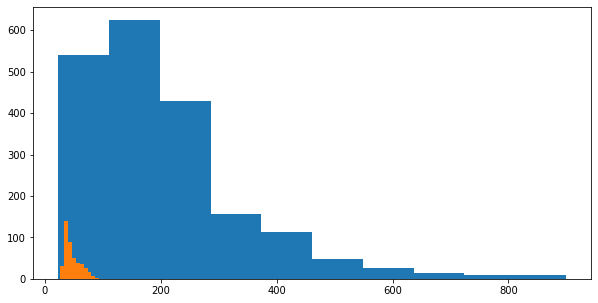

In [194]:
#branch_groups[:-int(len(branch_groups)/2)]
plt.hist(branch_full )
plt.hist(self_comp(b_mat_WT))
 #.flatten().tolist()

In [261]:
#b2_mat = np.mat(b_mat).T[inlier_ref].T
#plot_2_examples(['hot_r'],b2_mat);

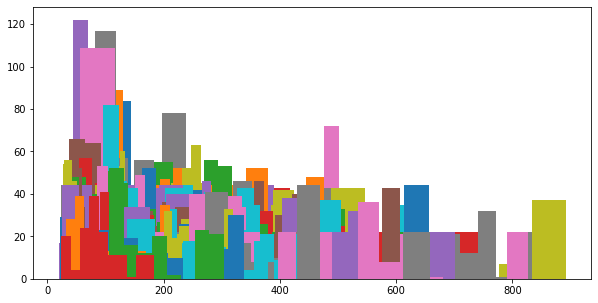

In [201]:
RNAi_WT_branch_distance_list =[]
branch_full = np.array([])
#jaccard_full = np.concatenate((jaccard_full,comparisons), axis=None)
for n in list(RNAi_size_assignments)[2:]:
    #print(n)
    #print(n,np.array(RNAi_size_assignments[n])-30,t_mat[np.array(RNAi_size_assignments[n])-30,0])
    branch_groups = b2_mat[np.array(RNAi_size_assignments[n])-30,:].flatten()
    branch_groups = branch_groups.tolist()[0]
    branch_full = np.concatenate((branch_full,np.array(branch_groups)[:-int(len(branch_groups)/1.05)]), axis=None)
    RNAi_WT_branch_distance_list.append(branch_groups)
    plt.hist(branch_groups)

(array([ 6., 23., 65., 71., 35., 18.,  9.,  2.,  1.,  1.]),
 array([26.11512971, 29.94333723, 33.77154475, 37.59975227, 41.42795979,
        45.25616731, 49.08437483, 52.91258235, 56.74078987, 60.56899739,
        64.39720491]),
 <BarContainer object of 10 artists>)

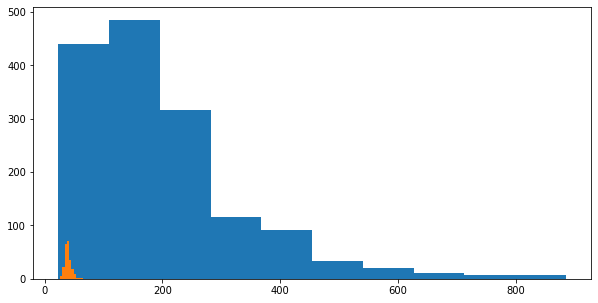

In [202]:
plt.hist(branch_full )
plt.hist(self_comp(b_mat_WT[inlier_ref].T[inlier_ref]))
#plot_2_examples(['hot_r'],);


In [150]:
RNAi_WT_branch_significance_matrix = []
for n in RNAi_WT_branch_distance_list:
    RNAi_WT_branch_significance_row = []
    for m in RNAi_WT_branch_distance_list:
        RNAi_WT_branch_significance_row.append(novel_two_sample_permutation_test(n,m,20))
    RNAi_WT_branch_significance_matrix.append(RNAi_WT_branch_significance_row)

RNAi_WT_branch_significance_row = np.mat(RNAi_WT_branch_significance_row)

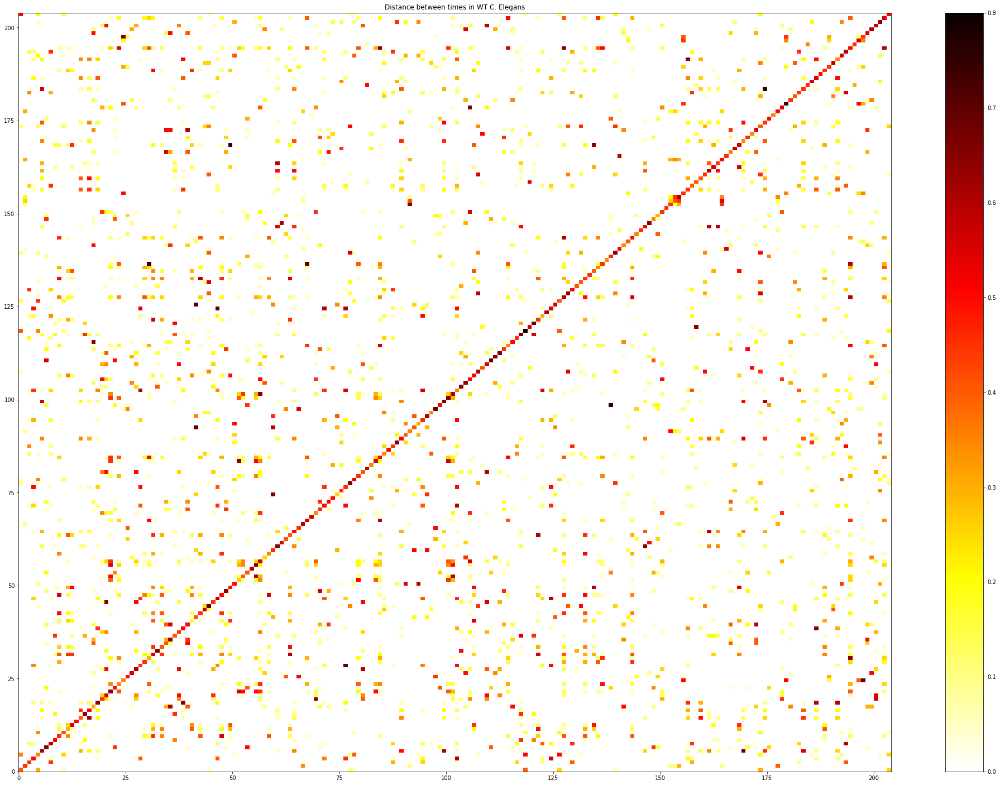

In [151]:
plot_2_examples(['hot_r'],RNAi_WT_branch_significance_matrix)

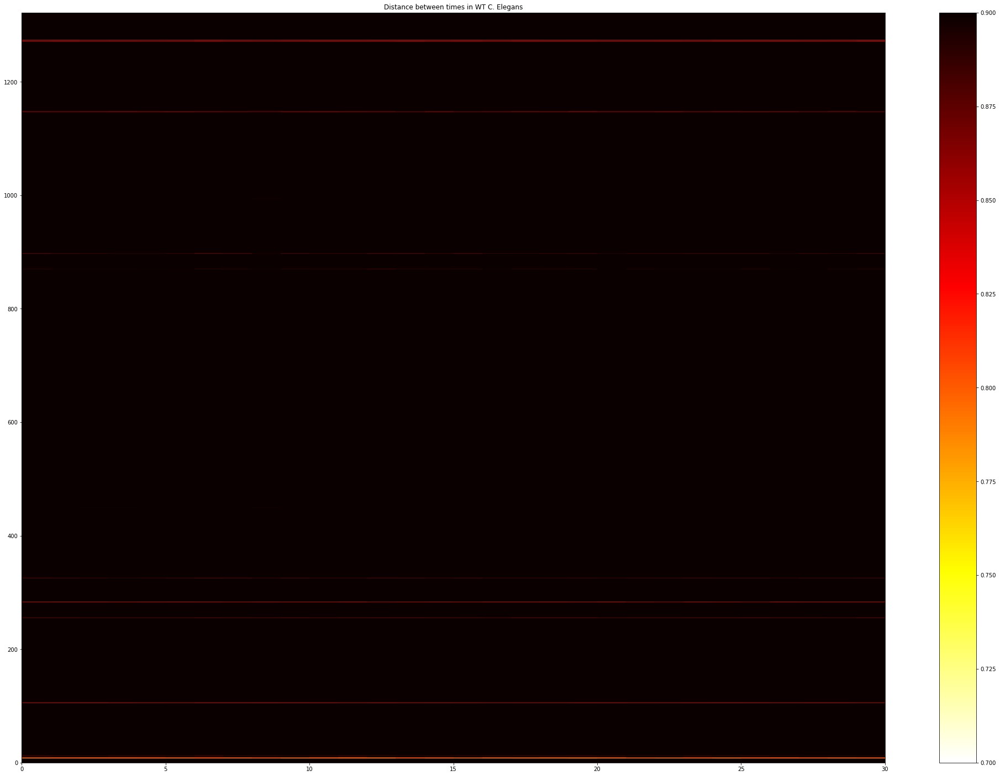

In [205]:
plot_2_examples(['hot_r'],np.mat(cos_mat))

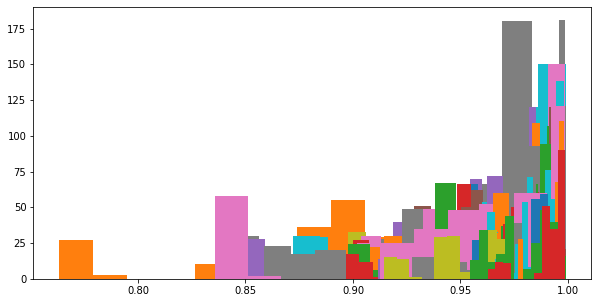

In [245]:
RNAi_WT_cosine_distance_list =[]
cosine_full = np.array([])
#jaccard_full = np.concatenate((jaccard_full,comparisons), axis=None)
for n in list(RNAi_size_assignments)[2:]:
    #print(n)
    #print(n,np.array(RNAi_size_assignments[n])-30,t_mat[np.array(RNAi_size_assignments[n])-30,0])
    cosine_groups = cos_mat[np.array(RNAi_size_assignments[n])-30,:].flatten()
    cosine_groups = cosine_groups.tolist()[0]
    cosine_full = np.concatenate((cosine_full,np.array(cosine_groups)[:-int(len(cosine_groups)/1.05)]), axis=None)
    RNAi_WT_cosine_distance_list.append(cosine_groups)
    plt.hist(cosine_groups)

(array([ 20.,  27.,  35.,  42.,  76.,  90., 165., 246., 406., 860.]),
 array([0.89651949, 0.90677448, 0.91702947, 0.92728447, 0.93753946,
        0.94779445, 0.95804944, 0.96830443, 0.97855942, 0.98881441,
        0.9990694 ]),
 <BarContainer object of 10 artists>)

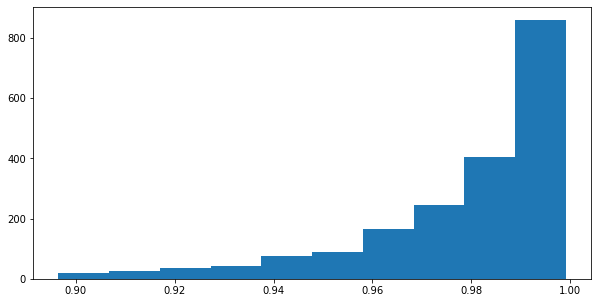

In [246]:
plt.hist(cosine_full)

In [12]:

RNAi_WT_branch_means_list =[];RNAi_WT_branch_std_list =[]
RNAi_WT_jaccard_means_list =[];RNAi_WT_jaccard_std_list =[]
RNAi_WT_cosine_means_list =[];RNAi_WT_cosine_std_list =[]
Gene_ranking_list = []
#jaccard_full = np.concatenate((jaccard_full,comparisons), axis=None)
for n in list(RNAi_size_assignments)[2:]:
    #print(n)
    #print(n,np.array(RNAi_size_assignments[n])-30,t_mat[np.array(RNAi_size_assignments[n])-30,0])
    branch_groups = b2_mat[np.array(RNAi_size_assignments[n])-30,:].flatten()
    branch_groups = branch_groups.tolist()[0]
    jaccard_groups = j_mat[np.array(RNAi_size_assignments[n])-30,:].flatten() * 100
    jaccard_groups = jaccard_groups.tolist()[0]
    cosine_groups = cos_mat[np.array(RNAi_size_assignments[n])-30,:].flatten() * 100
    cosine_groups = cosine_groups.tolist()[0]
    RNAi_WT_branch_means_list.append(np.mean(branch_groups));RNAi_WT_branch_std_list.append(np.std(branch_groups))
    RNAi_WT_jaccard_means_list.append(np.mean(jaccard_groups));RNAi_WT_jaccard_std_list.append(np.std(jaccard_groups ))
    RNAi_WT_cosine_means_list.append(np.mean(cosine_groups ));RNAi_WT_cosine_std_list.append(np.std(cosine_groups ))
    ranking_tuple = (n,np.mean(jaccard_groups),np.mean(branch_groups),np.mean(cosine_groups ))
    #print(ranking_tuple)
    Gene_ranking_list.append(ranking_tuple)
    #plt.hist(branch_groups)

'\nRNAi_WT_branch_means_list =[];RNAi_WT_branch_std_list =[]\nRNAi_WT_jaccard_means_list =[];RNAi_WT_jaccard_std_list =[]\nRNAi_WT_cosine_means_list =[];RNAi_WT_cosine_std_list =[]\nGene_ranking_list = []\n#jaccard_full = np.concatenate((jaccard_full,comparisons), axis=None)\nfor n in list(RNAi_size_assignments)[2:]:\n    #print(n)\n    #print(n,np.array(RNAi_size_assignments[n])-30,t_mat[np.array(RNAi_size_assignments[n])-30,0])\n    branch_groups = b2_mat[np.array(RNAi_size_assignments[n])-30,:].flatten()\n    branch_groups = branch_groups.tolist()[0]\n    jaccard_groups = j_mat[np.array(RNAi_size_assignments[n])-30,:].flatten() * 100\n    jaccard_groups = jaccard_groups.tolist()[0]\n    cosine_groups = cos_mat[np.array(RNAi_size_assignments[n])-30,:].flatten() * 100\n    cosine_groups = cosine_groups.tolist()[0]\n    RNAi_WT_branch_means_list.append(np.mean(branch_groups));RNAi_WT_branch_std_list.append(np.std(branch_groups))\n    RNAi_WT_jaccard_means_list.append(np.mean(jaccard_gr

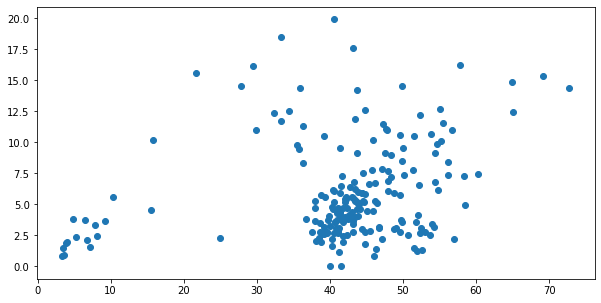

In [256]:
plt.scatter(RNAi_WT_jaccard_means_list,RNAi_WT_jaccard_std_list)

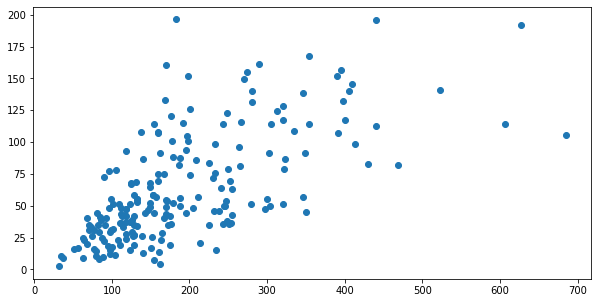

In [257]:
plt.scatter(RNAi_WT_branch_means_list,RNAi_WT_branch_std_list)

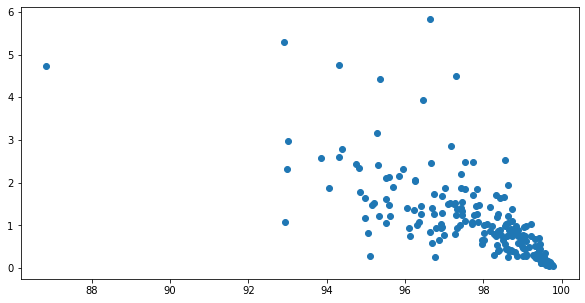

In [258]:
plt.scatter(RNAi_WT_cosine_means_list,RNAi_WT_cosine_std_list)

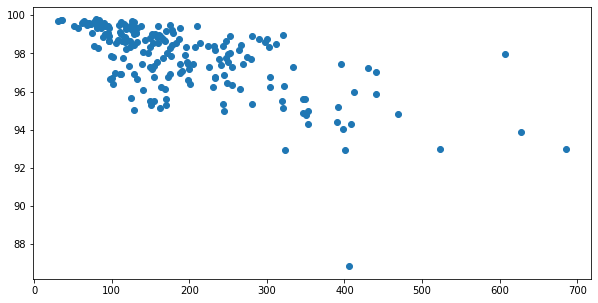

In [259]:
plt.scatter(RNAi_WT_branch_means_list,RNAi_WT_cosine_means_list)

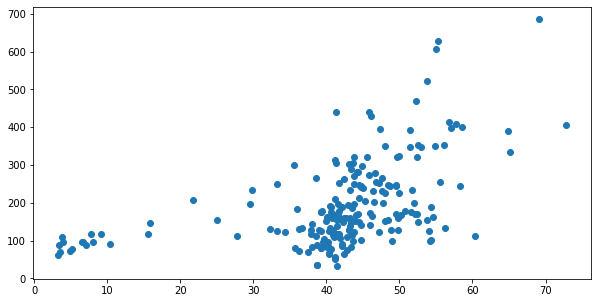

In [219]:
plt.scatter(RNAi_WT_jaccard_means_list,RNAi_WT_branch_means_list)

In [10]:
#sorted(Gene_ranking_list, key = lambda x: -x[3])

In [129]:
np.where(RNAi_name_array == 'C55A6.9')

(array([ 97,  98,  99, 100, 101, 102, 103]),)

In [263]:
b_mat_2 = []
jaccard_mat_2 = []
t_mat_2 = []
cos_mat_2 = []
for n in range(0,len(fulldictset)):
    t_row = []
    r_row = []
    b_row = []
    cos_row = []
    for m in range(0,len(fulldictset)):
        #go = cleaner(refdictset,refglobaldictset,m,match_links,dictset,globaldictset,n)
        go = fulldictset[m]
        r_row.append(jaccard_distance(go,fulldictset[n]))
        t_row.append(tree_edit_distance(go,fulldictset[n]))
        b_row.append(branch_distance(go,fulldictset[n]))
        cos_row.append(cosine_pseudodistance(go,fulldictset[n]))
    jaccard_mat_2.append(r_row)
    t_mat_2.append(t_row)
    b_mat_2.append(b_row)
    cos_mat_2.append(cos_row)
    if n % 50 == 0: print(n / len(fulldictset))
jaccard_mat_2 = np.mat(jaccard_mat_2)
b_mat_2 = np.mat(b_mat_2)
t_mat_2 = np.mat(t_mat_2)
cos_mat_2 = np.mat(cos_mat_2)

print(jaccard_mat_2 .shape,b_mat_2.shape,t_mat_2.shape, cos_mat_2.shape)

'b_mat_2 = []\njaccard_mat_2 = []\nt_mat_2 = []\ncos_mat_2 = []\nfor n in range(0,len(fulldictset)):\n    t_row = []\n    r_row = []\n    b_row = []\n    cos_row = []\n    for m in range(0,len(fulldictset)):\n        #go = cleaner(refdictset,refglobaldictset,m,match_links,dictset,globaldictset,n)\n        go = fulldictset[m]\n        r_row.append(jaccard_distance(go,fulldictset[n]))\n        t_row.append(tree_edit_distance(go,fulldictset[n]))\n        b_row.append(branch_distance(go,fulldictset[n]))\n        cos_row.append(cosine_pseudodistance(go,fulldictset[n]))\n    jaccard_mat_2.append(r_row)\n    t_mat_2.append(t_row)\n    b_mat_2.append(b_row)\n    cos_mat_2.append(cos_row)\n    if n % 50 == 0: print(n / len(fulldictset))\njaccard_mat_2 = np.mat(jaccard_mat_2)\nb_mat_2 = np.mat(b_mat_2)\nt_mat_2 = np.mat(t_mat_2)\ncos_mat_2 = np.mat(cos_mat_2)\n\nprint(jaccard_mat_2 .shape,b_mat_2.shape,t_mat_2.shape, cos_mat_2.shape)'

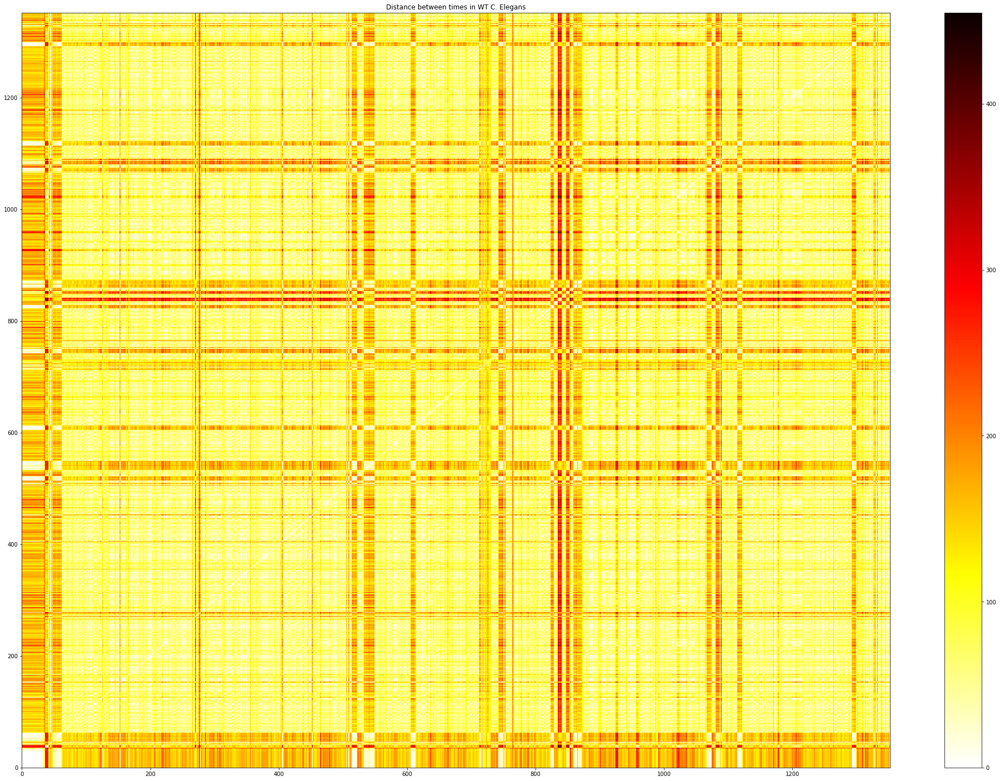

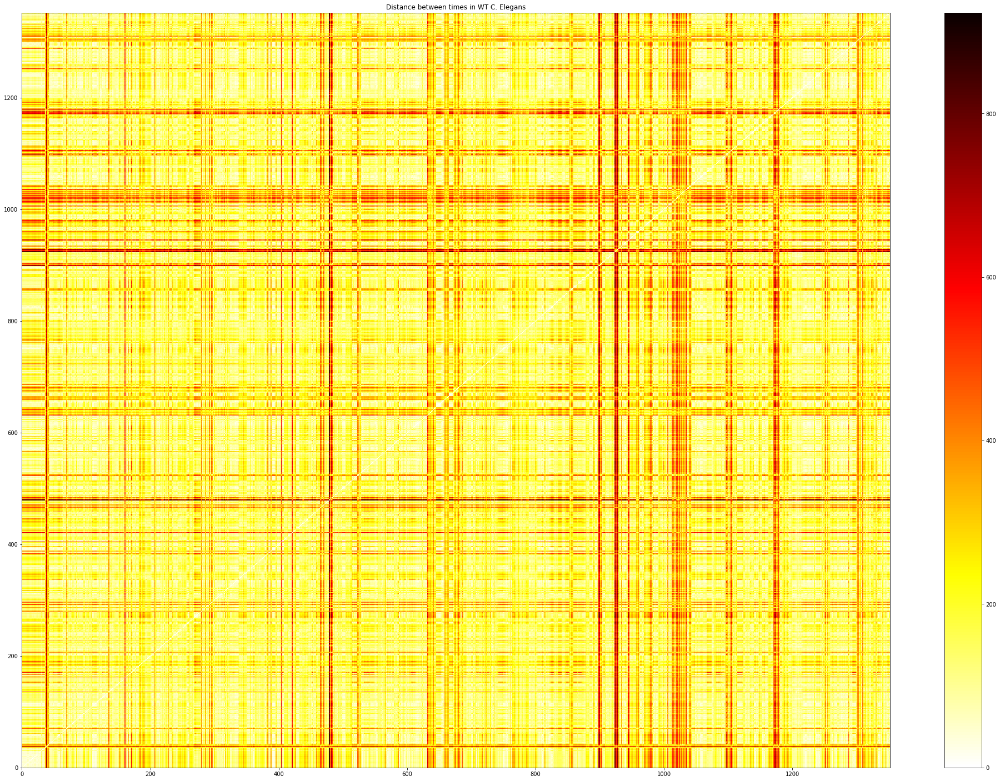

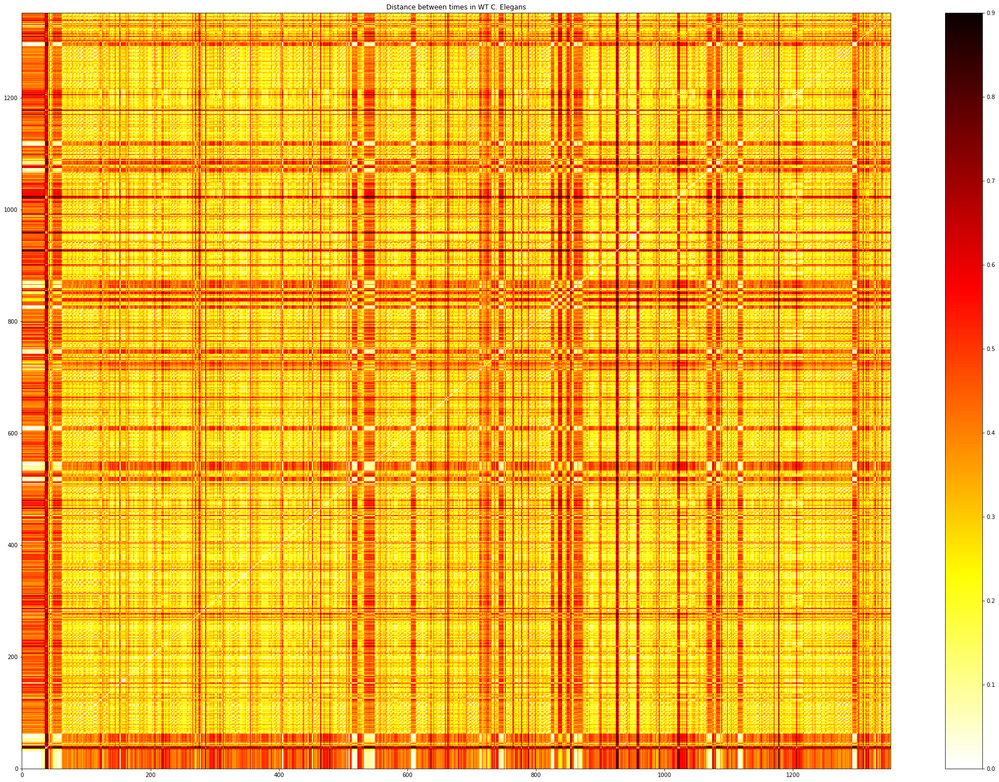

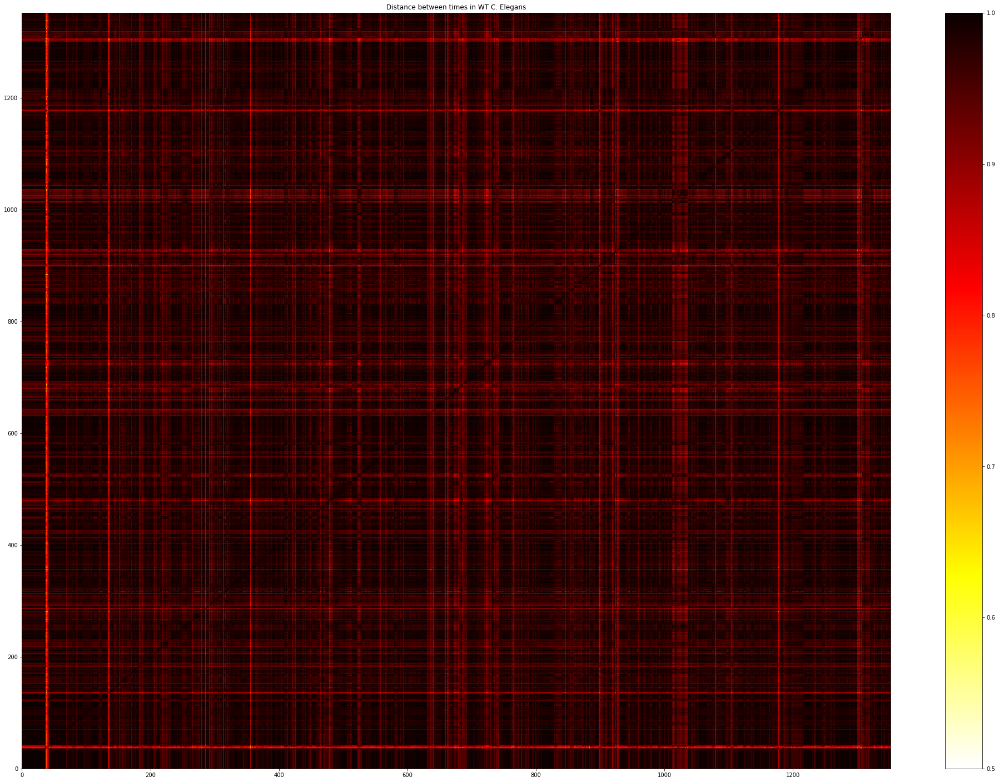

In [491]:
plot_2_examples(['hot_r'],np.mat(t_mat_2));
plot_2_examples(['hot_r'],np.mat(b_mat_2));
plot_2_examples(['hot_r'],np.mat(jaccard_mat_2));
plot_2_examples(['hot_r'],np.mat(cos_mat_2))

/tmp/ipykernel_468466/1864566692.py:1: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  Z = linkage(np.mat(t_mat_2), 'average')


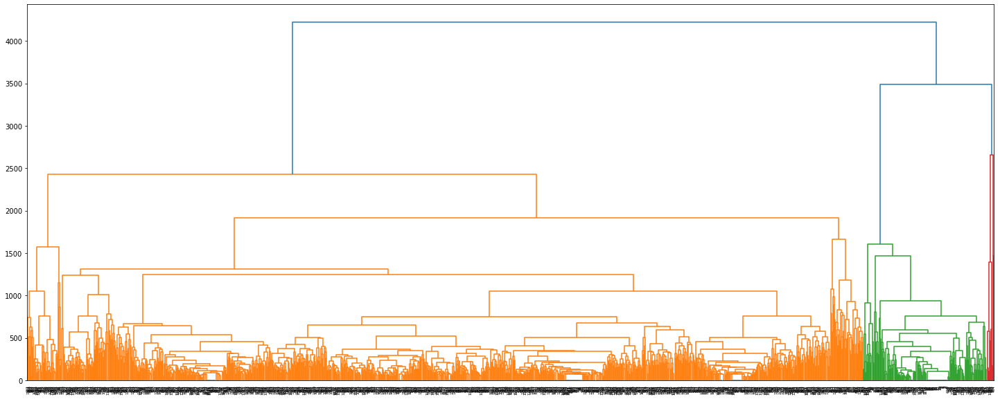

In [99]:
Z = linkage(np.mat(t_mat_2), 'average')
fig = plt.figure(figsize=(25, 10))
dn = dendrogram(Z)

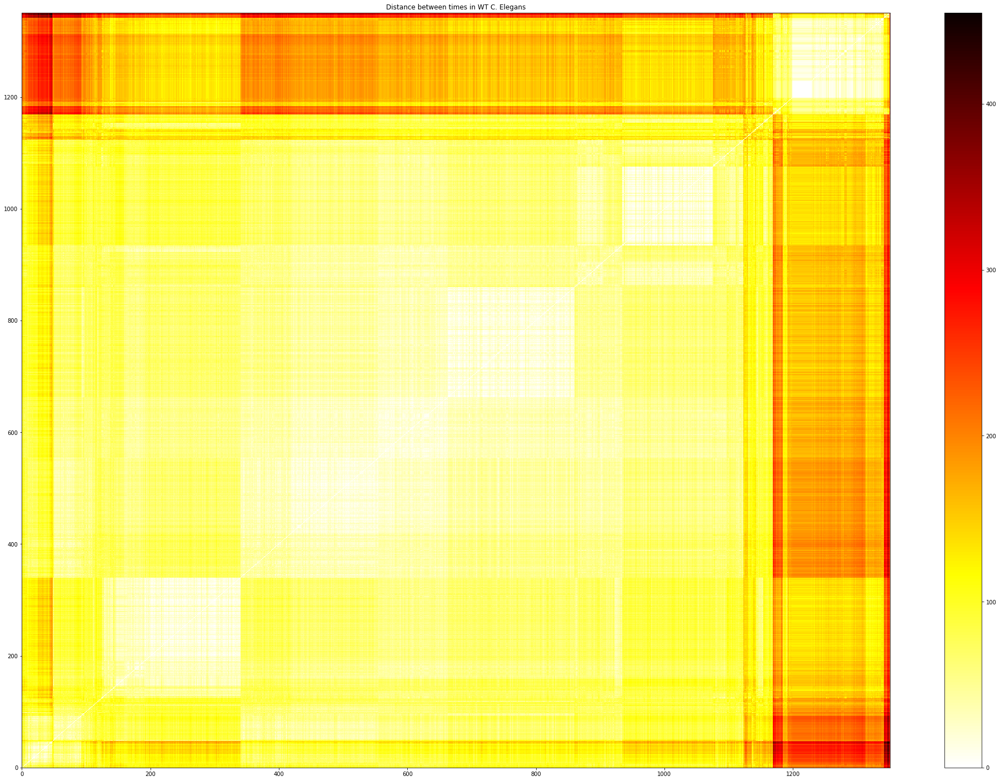

In [114]:
clusters = 100
que = fcluster(Z, t=clusters, criterion='maxclust')
oop = np.where(que == 1)[0].tolist()
for n in range(2,clusters):
    oop = oop + np.where(que == n)[0].tolist()
plot_2_examples(['hot_r'],(np.mat(t_mat_2)[oop]).T[oop])

/tmp/ipykernel_468466/4250397917.py:1: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  Z = linkage(np.mat(b_mat_2), 'average')


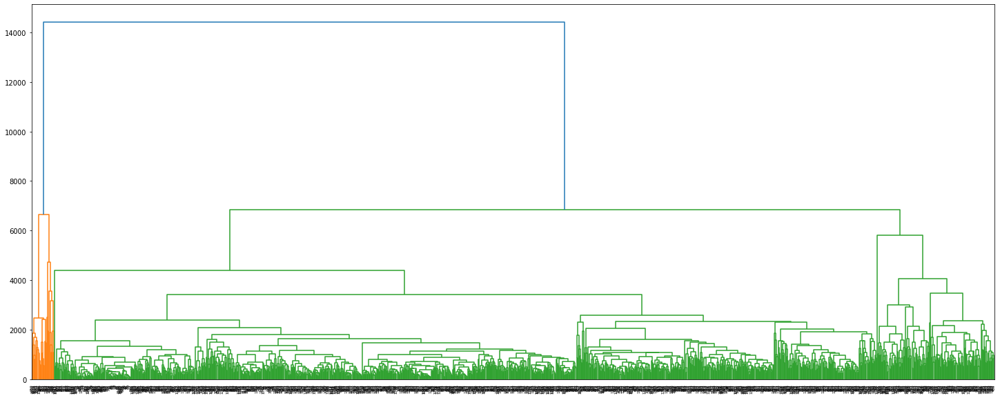

In [494]:
Z = linkage(np.mat(b_mat_2), 'average')
fig = plt.figure(figsize=(25, 10))
dn = dendrogram(Z)

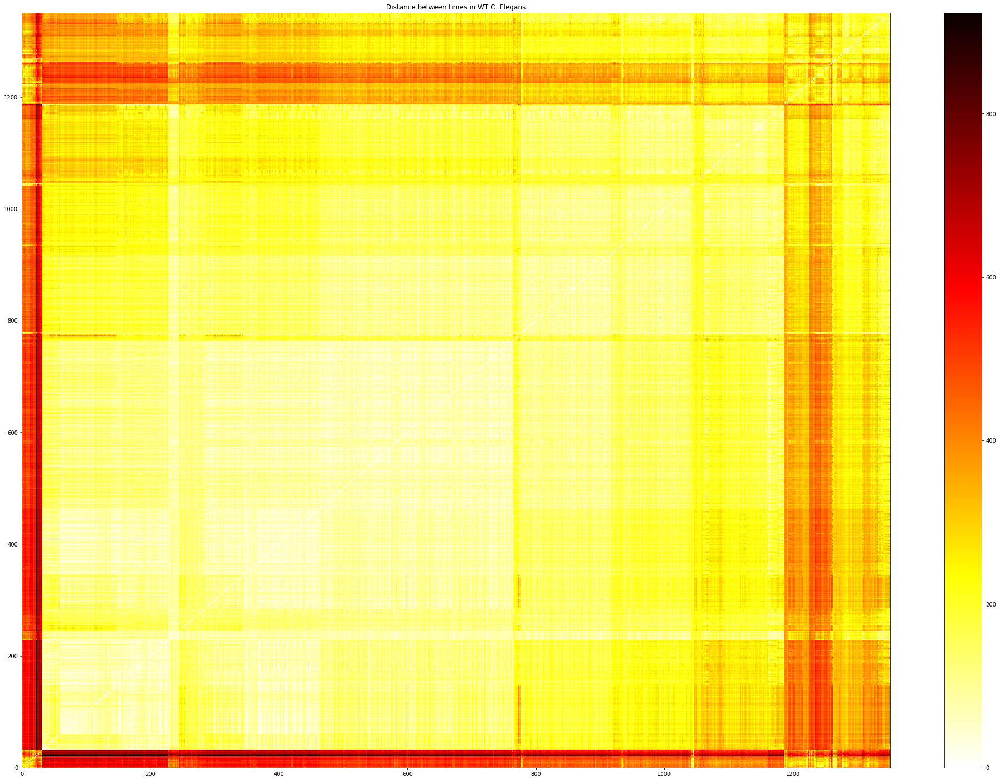

In [495]:
clusters = 100
que = fcluster(Z, t=clusters, criterion='maxclust')
oop = np.where(que == 1)[0].tolist()
for n in range(2,clusters):
    oop = oop + np.where(que == n)[0].tolist()
plot_2_examples(['hot_r'],(np.mat(b_mat_2)[oop]).T[oop])

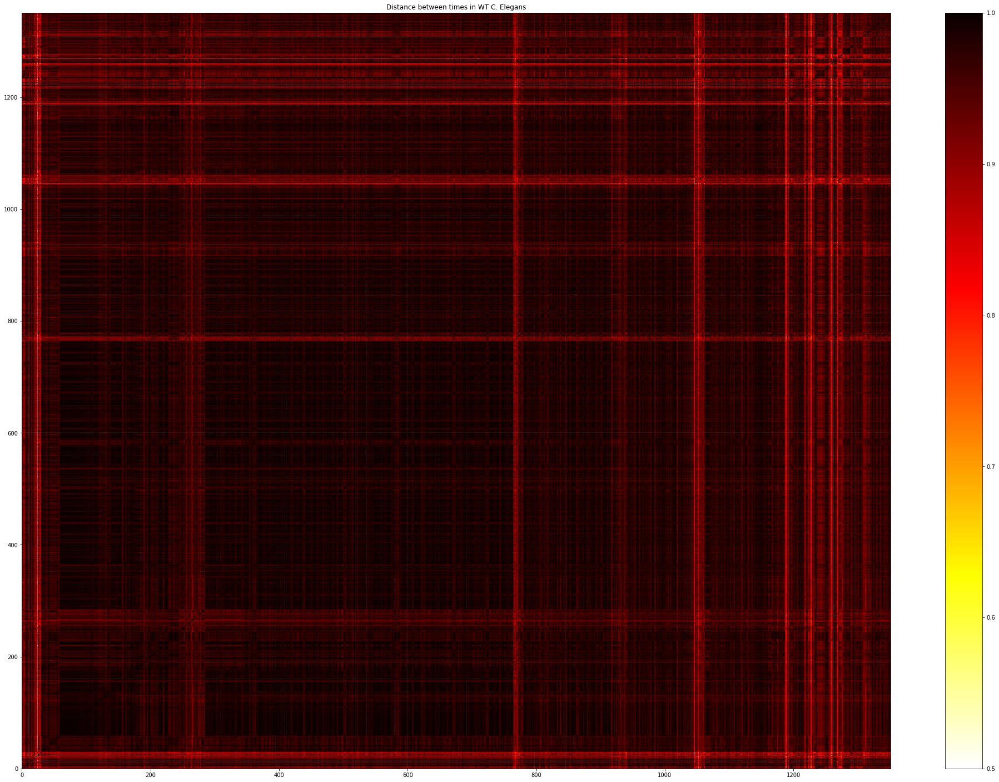

In [497]:
plot_2_examples(['hot_r'],(np.mat(cos_mat_2)[oop]).T[oop])

/tmp/ipykernel_468466/3153349989.py:1: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  Z = linkage(np.mat(jaccard_mat_2), 'average')


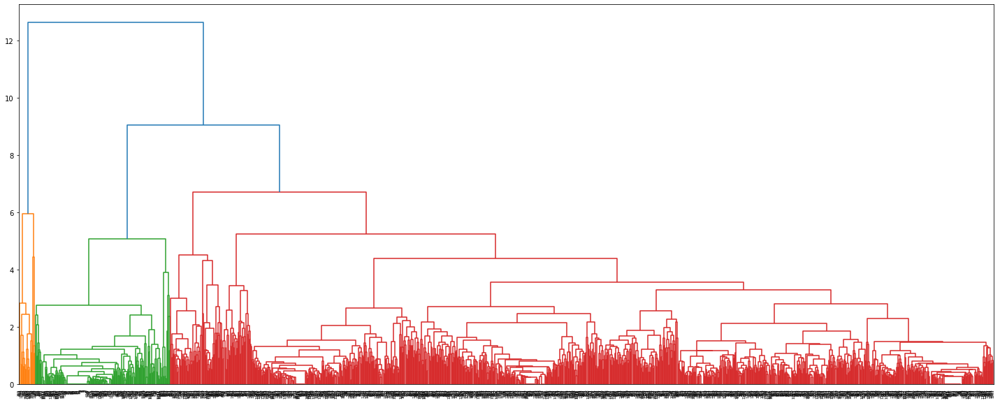

In [282]:
Z = linkage(np.mat(jaccard_mat_2), 'average')
fig = plt.figure(figsize=(25, 10))
dn = dendrogram(Z)

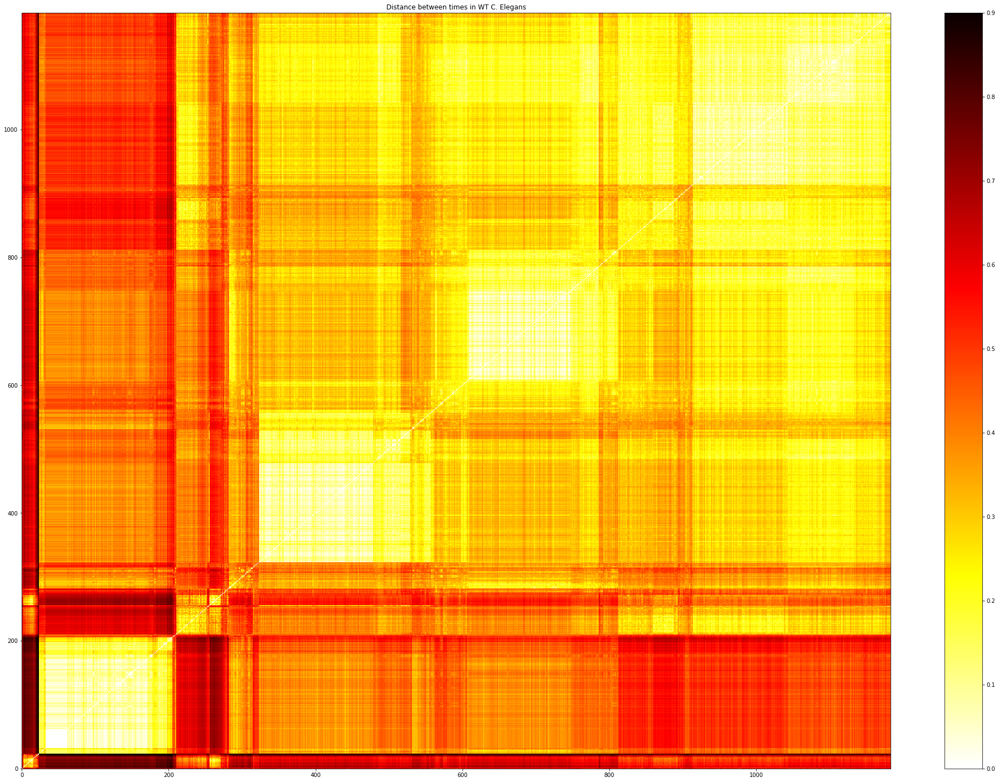

In [283]:
clusters = 100
que = fcluster(Z, t=clusters, criterion='maxclust')
oop = np.where(que == 1)[0].tolist()
for n in range(2,clusters):
    oop = oop + np.where(que == n)[0].tolist()
plot_2_examples(['hot_r'],(np.mat(jaccard_mat_2)[oop]).T[oop])

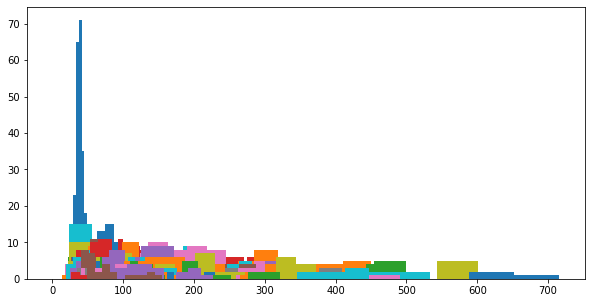

In [225]:
self_full_branch_comparisons = dict()
total_branch = np.array([])
for n in RNAi_size_assignments:
    comparisons = self_comp((np.mat(b_mat_2)[RNAi_size_assignments[n]]).T[RNAi_size_assignments[n]])
    self_full_branch_comparisons[n] = comparisons
    total_branch = np.concatenate((total_branch,comparisons), axis=None)
    plt.hist(comparisons)

(array([1738., 1365.,  492.,  245.,  132.,   49.,   29.,    6.,    8.,
           2.]),
 array([ 13.37908816,  83.64166817, 153.90424818, 224.16682819,
        294.4294082 , 364.69198821, 434.95456821, 505.21714822,
        575.47972823, 645.74230824, 716.00488825]),
 <BarContainer object of 10 artists>)

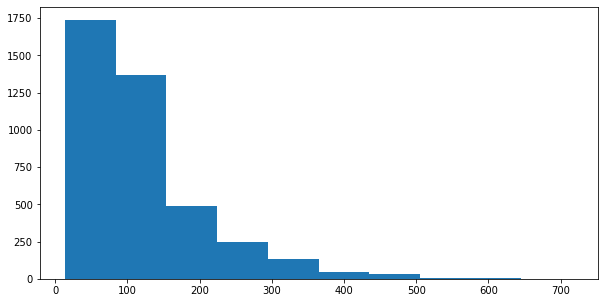

In [226]:
plt.hist(total_branch)

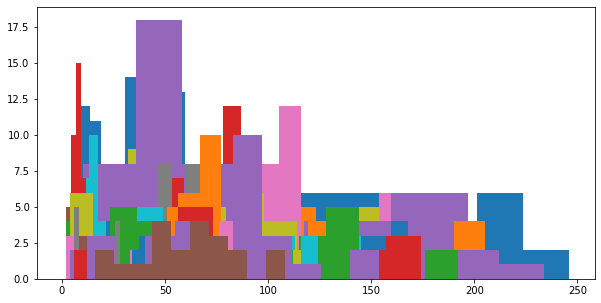

In [227]:
self_full_tree_comparisons = dict()
total_full = np.array([])

for n in RNAi_size_assignments:
    comparisons = self_comp((np.mat(t_mat_2)[RNAi_size_assignments[n]]).T[RNAi_size_assignments[n]])
    self_full_tree_comparisons[n] = comparisons
    total_full = np.concatenate((total_full,comparisons), axis=None)
    plt.hist(comparisons)

(array([ 891.,  832., 1071.,  622.,  170.,  102.,   49.,   35.,   13.,
           3.]),
 array([  2. ,  26.4,  50.8,  75.2,  99.6, 124. , 148.4, 172.8, 197.2,
        221.6, 246. ]),
 <BarContainer object of 10 artists>)

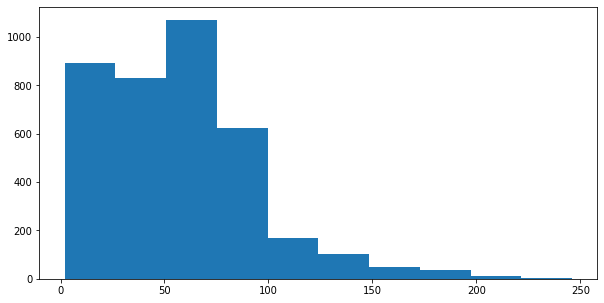

In [228]:
plt.hist(total_full)

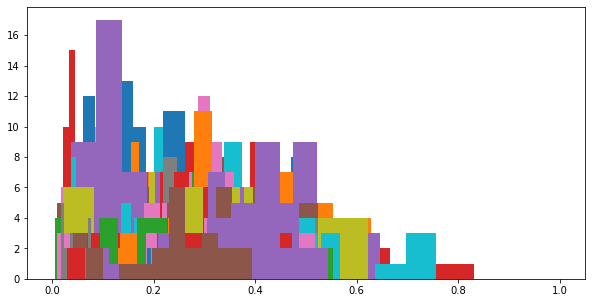

In [229]:
jaccard_full = np.array([])
self_full_jaccard_comparisons = dict()
for n in RNAi_size_assignments:
    comparisons = self_comp((np.mat(jaccard_mat_2)[RNAi_size_assignments[n]]).T[RNAi_size_assignments[n]])
    self_full_jaccard_comparisons[n] = comparisons
    jaccard_full = np.concatenate((jaccard_full,comparisons), axis=None)
    plt.hist(comparisons)

(array([650., 637., 813., 978., 429., 166.,  78.,  28.,   6.,   3.]),
 array([0.00544959, 0.0880679 , 0.1706862 , 0.25330451, 0.33592282,
        0.41854112, 0.50115943, 0.58377773, 0.66639604, 0.74901435,
        0.83163265]),
 <BarContainer object of 10 artists>)

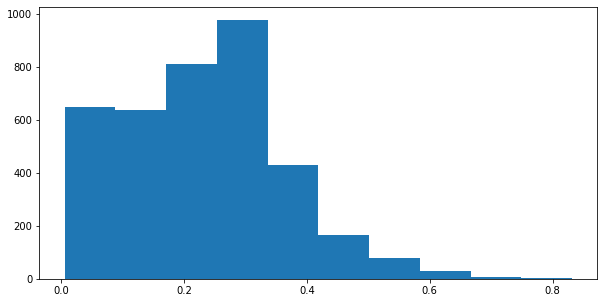

In [230]:
plt.hist(jaccard_full)

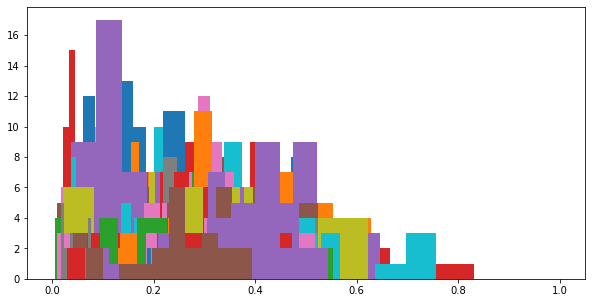

In [231]:
cosine_full = np.array([])
self_full_cosine_comparisons = dict()
for n in RNAi_size_assignments:
    comparisons = self_comp((np.mat(jaccard_mat_2)[RNAi_size_assignments[n]]).T[RNAi_size_assignments[n]])
    self_full_cosine_comparisons[n] = comparisons
    jaccard_full = np.concatenate((cosine_full,comparisons), axis=None)
    plt.hist(comparisons)

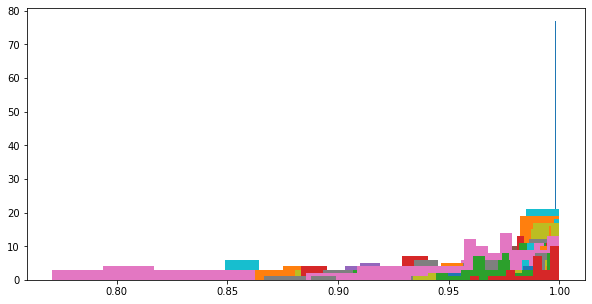

In [233]:
cosine_full = np.array([])
self_full_cosine_comparisons = dict() 
for n in RNAi_size_assignments: 
    comparisons = self_comp((np.mat(cos_mat_2)[RNAi_size_assignments[n]]).T[RNAi_size_assignments[n]]) 
    self_full_cosine_comparisons[n] = comparisons 
    #print(n,np.mean(comparisons)) 
    if np.mean(comparisons) < 1:
        cosine_full = np.concatenate((cosine_full,comparisons), axis=None) 
        plt.hist(comparisons)

(array([4.000e+00, 5.000e+00, 4.000e+00, 1.500e+01, 1.900e+01, 3.000e+01,
        8.500e+01, 1.860e+02, 6.420e+02, 4.426e+03]),
 array([0.77092519, 0.79383267, 0.81674015, 0.83964763, 0.86255511,
        0.88546259, 0.90837007, 0.93127756, 0.95418504, 0.97709252,
        1.        ]),
 <BarContainer object of 10 artists>)

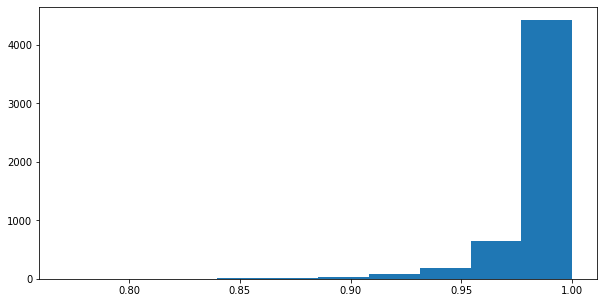

In [234]:
plt.hist(cosine_full)

In [238]:
#dict_PCA_img(fullnameset,fulldictset,100,2)
#PCA_slope(refdictset[100],refdictset[100])
#dict_PCA(refnameset,refdictset,100,2)
#PCA_slope(fulldictset[100],fulldictset[2])
#cosine_pseudodistance(fulldictset[100],fulldictset[2])

In [236]:
self_full_tree_comparisons['inlierWT'] = np.array([0])
self_full_tree_comparisons['outlierWT'] = np.array([0])
self_full_jaccard_comparisons['inlierWT'] = np.array([0])
self_full_jaccard_comparisons['outlierWT'] = np.array([0])

#RNAI_branch_significances
#for n in RNAi_size_assignments:
#    n_tree = self_full_tree_comparisons[n];n_jaccard = self_full_jaccard_comparisons[n]
    #for m in RNAi_size_assignments:
        #print(n,m)
        #print((np.mat(jaccard_mat_2)[RNAi_size_assignments[n]]).T[RNAi_size_assignments[m]].flatten().size)
    #print(RNAi_size_assignments[n])
    #print(self_full_branch_comparisons[n])
    #print(self_full_tree_comparisons[n])
    #print(self_full_jaccard_comparisons[n])

In [237]:
jac_mean_list = []; jac_var_list = []
branch_mean_list = []; branch_var_list = [];
cos_mean_list = []; cos_var_list = []
for n in list(self_full_jaccard_comparisons)[2:]:
    print(n)
    jac_mean_list.append(np.mean(self_full_jaccard_comparisons[n]*100))
    jac_var_list.append(np.std(self_full_jaccard_comparisons[n]*100))
    branch_mean_list.append(np.mean(self_full_branch_comparisons[n]))
    branch_var_list.append(np.std(self_full_branch_comparisons[n]))
    cos_mean_list.append(np.mean(self_full_cosine_comparisons[n] * 100))
    cos_var_list.append(np.std(self_full_cosine_comparisons[n] * 100))
    print('jaccard %', np.mean(self_full_jaccard_comparisons[n]*100), np.std(self_full_jaccard_comparisons[n]*100))
    print('branch', np.mean(self_full_branch_comparisons[n]), np.std(self_full_branch_comparisons[n]))
    print('cosine', np.mean(self_full_cosine_comparisons[n] * 100),np.std(self_full_cosine_comparisons[n] * 100))

ABI-1
jaccard % 16.817581568716665 5.868666833670774
branch 107.39483448326403 25.473179221401832
cosine 99.36559669067327 0.4695234532340214
AMA-1
jaccard % 53.14706587340522 16.707694113189955
branch 313.89368031026424 142.70630958234116
cosine 92.42571710078353 6.41256851583268
AOS-1
jaccard % 32.84844863597189 12.313048077725682
branch 73.32352934524512 22.436429700161998
cosine 99.17300951575491 0.6529003596738503
APR-1
jaccard % 14.557802568753063 3.86702008030033
branch 114.18405128757261 26.6120730413283
cosine 99.16947604298055 0.5949610296781003
APX-1
jaccard % 3.214483301379355 1.584981926783285
branch 113.54930794019349 89.97351409015702
cosine 99.63192557735024 0.3674839627547109
ARX-2
jaccard % 24.39102965256098 9.111251087231528
branch 73.09178129101265 27.95218848391136
cosine 99.69040570447048 0.2586561427918121
ATX-2
jaccard % 27.25605492929102 9.44910889994944
branch 188.7511389150433 120.6745246172835
cosine 98.6573388657934 1.7651731640021142
BUB-1
jaccard % 25.628

/home/gunalan/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/gunalan/.local/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/gunalan/.local/lib/python3.9/site-packages/numpy/core/_methods.py:262: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/gunalan/.local/lib/python3.9/site-packages/numpy/core/_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/home/gunalan/.local/lib/python3.9/site-packages/numpy/core/_methods.py:254: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


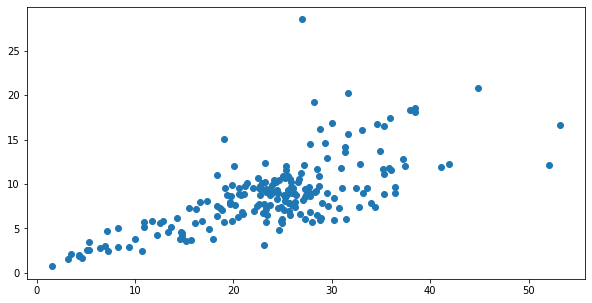

In [474]:
plt.scatter(jac_mean_list,jac_var_list)

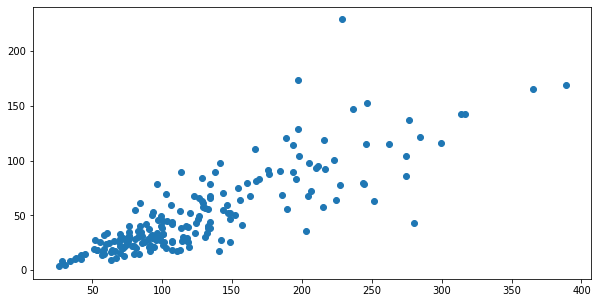

In [475]:
plt.scatter(branch_mean_list,branch_var_list)

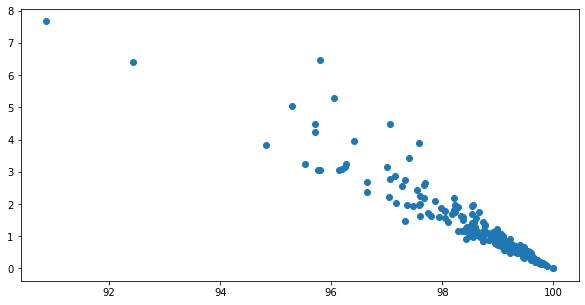

In [510]:
plt.scatter(cos_mean_list, cos_var_list)

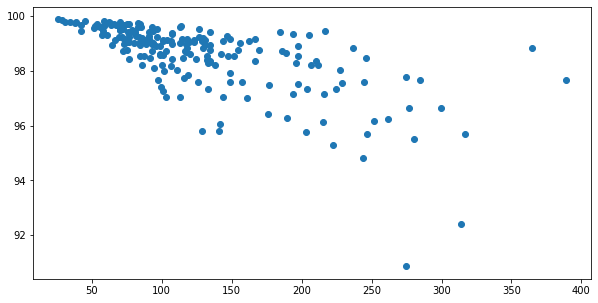

In [511]:
plt.scatter(branch_mean_list,cos_mean_list)

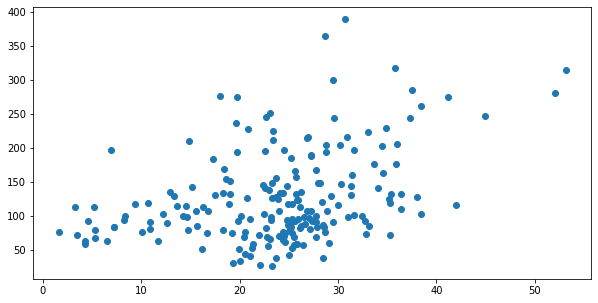

In [477]:
plt.scatter(jac_mean_list,branch_mean_list)

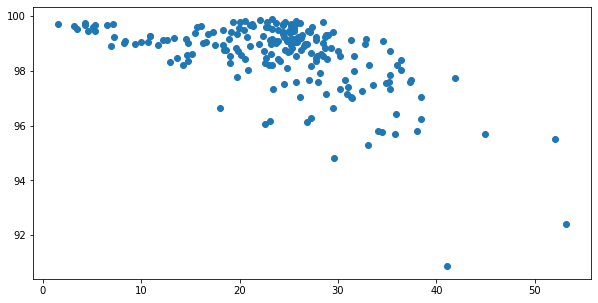

In [512]:
plt.scatter(jac_mean_list,cos_mean_list)

In [437]:
np.where(RNAi_name_array == 'CHAF-2')

(array([195, 196, 197, 198, 199, 200, 201]),)

In [445]:
RNAi_name_array[np.where(t_mat_2[198] < 15 )[1]]

array(['C07A9.2', 'C07A9.2', 'CACN-1', 'CDK-7', 'CDK-7', 'CDK-9',
       'CHAF-2', 'CHAF-2', 'CHAF-2', 'CHAF-2', 'CHAF-2', 'CHAF-2',
       'CHAF-2', 'CLS-2', 'CPSF-2', 'DIV-1', 'DIV-1', 'DIV-1', 'DIV-1',
       'DIV-1', 'F20D12.2', 'F20D12.2', 'F23F1.5', 'F31C3.5', 'F55A3.7',
       'GAD-1', 'GAD-1', 'GLD-2', 'LET-502', 'LET-502', 'LRR-1', 'LRR-1',
       'PCN-1', 'R05H5.3', 'R05H5.3', 'RBA-1', 'RBA-1', 'RBA-1', 'RBA-1',
       'RBA-1', 'RBA-1', 'RBA-1', 'RBA-1', 'RBA-1', 'RBA-1', 'RBA-1',
       'REV-1', 'RGR-1', 'RNP-4', 'SKR-2', 'SPG-7', 'SPG-7', 'T13H5.5',
       'ZYG-11'], dtype='<U45')

In [449]:
RNAi_name_array[np.where(jaccard_mat_2[198] < .08 )[1]]

array(['C07A9.2', 'C07A9.2', 'CACN-1', 'CDK-7', 'CDK-7', 'CDK-9',
       'CHAF-2', 'CHAF-2', 'CHAF-2', 'CHAF-2', 'CHAF-2', 'CHAF-2',
       'CHAF-2', 'CLS-2', 'CPSF-2', 'DIV-1', 'DIV-1', 'DIV-1', 'DIV-1',
       'DIV-1', 'F20D12.2', 'F20D12.2', 'F23F1.5', 'F31C3.5', 'F55A3.7',
       'GAD-1', 'GAD-1', 'GLD-2', 'LET-502', 'LET-502', 'LRR-1', 'LRR-1',
       'NPP-2', 'OMA-1', 'PCN-1', 'R05H5.3', 'R05H5.3', 'RBA-1', 'RBA-1',
       'RBA-1', 'RBA-1', 'RBA-1', 'RBA-1', 'RBA-1', 'RBA-1', 'RBA-1',
       'RBA-1', 'RBA-1', 'REV-1', 'RGR-1', 'RNP-4', 'SKR-2', 'SPG-7',
       'SPG-7', 'T13H5.5', 'TBX-33', 'ZYG-11'], dtype='<U45')

In [457]:
RNAi_name_array[np.where(b_mat_2[198] < 120 )[1]]

array(['C06A5.1', 'CACN-1', 'CDC-37', 'CDK-7', 'CDK-7', 'CDK-9', 'CEH-24',
       'CEH-24', 'CHAF-2', 'CHAF-2', 'CHAF-2', 'CHAF-2', 'CHAF-2',
       'CHAF-2', 'CHAF-2', 'CIR-1', 'CMD-1', 'CMD-1', 'CMD-1', 'CPL-1',
       'CPSF-1', 'CPSF-1', 'CPSF-2', 'CUL-2', 'DIE-1', 'DIE-1', 'DIV-1',
       'DIV-1', 'DIV-1', 'DIV-1', 'DIV-1', 'DIV-1', 'DIV-1', 'DIV-1',
       'DIV-1', 'DIV-1', 'EGO-1', 'EGO-1', 'F19F10.9', 'F19F10.9',
       'F25B3.6', 'F31C3.5', 'F31C3.5', 'F31C3.5', 'F31C3.5', 'F31C3.5',
       'F31C3.5', 'F35F11.1', 'F35F11.1', 'F35F11.1', 'F43E2.7',
       'F43G9.12', 'F43G9.12', 'F43G9.12', 'F44B9.8', 'F44B9.8',
       'F55A3.7', 'GAD-1', 'GAD-1', 'GEI-11', 'GEI-11', 'GEI-17',
       'KLP-10', 'KLP-10', 'LET-502', 'LET-711', 'LIG-1', 'LIN-53',
       'MDT-6', 'MDT-6', 'MDT-6', 'MEI-1', 'NPP-1', 'NPP-2', 'NPP-6',
       'NPP-6', 'NUD-1', 'PABP-2', 'PPFR-4', 'R11A8.2', 'RAN-4', 'RAN-4',
       'RBA-1', 'RBA-1', 'RBA-1', 'RBA-1', 'RBA-1', 'RBA-1', 'RBA-1',
       'RBA-1', 'RBA-1', 

In [522]:
RNAi_name_array[np.where(cos_mat_2[198] > 1-.01 )[1]]

array(['C08B11.3', 'C55A6.9', 'CAMT-1', 'CDK-7', 'CDK-7', 'CDK-7',
       'CHAF-2', 'CHAF-2', 'CHAF-2', 'CHAF-2', 'CHAF-2', 'CHAF-2',
       'CHAF-2', 'CHK-1', 'CPSF-1', 'CPSF-1', 'CPSF-4', 'EMB-5',
       'F25B3.6', 'F25B3.6', 'F25B3.6', 'F31C3.5', 'F31C3.5', 'F31C3.5',
       'F31C3.5', 'F44B9.8', 'GAD-1', 'GEI-17', 'HIS-9', 'KLP-10',
       'KLP-15', 'LET-502', 'LET-502', 'LET-502', 'LET-526', 'LET-526',
       'LIN-26', 'MDT-19', 'MDT-19', 'MDT-6', 'MDT-6', 'MDT-6', 'MDT-6',
       'MOG-5', 'NMY-2', 'R11A8.2', 'RBA-1', 'RBA-1', 'RBA-1', 'RBA-1',
       'RBA-1', 'RBA-1', 'RBA-1', 'RBA-1', 'RBA-1', 'RBA-1', 'RBA-1',
       'RBX-1', 'REPO-1', 'REV-1', 'REV-1', 'REV-1', 'REV-1', 'REV-1',
       'REV-1', 'RFC-3', 'RFC-3', 'RGR-1', 'RGR-1', 'RNF-113', 'RNF-113',
       'RNP-7', 'RNP-7', 'RUVB-1', 'RUVB-1', 'SEL-8', 'T04A8.7',
       'T04A8.7', 'T09A5.9', 'T10F2.4', 'T10F2.4', 'T24C4.5', 'T24C4.5',
       'T24C4.5', 'UBA-1', 'UBC-9', 'VAB-10', 'VPS-32.1', 'VPS-32.1',
       'VPS-4', 'VPS-

In [523]:
used_index = 198; numerical_cutoff = 50

branch_proximity = np.argsort(b_mat_2[used_index]); 
branch_proximity = np.array(branch_proximity[0])[0][0:numerical_cutoff]
selected_branches = b_mat_2[used_index,branch_proximity].tolist()[0]; 
selected_jaccard = jaccard_mat_2[used_index,branch_proximity].tolist()[0]
selected_cosine = cos_mat_2[used_index,branch_proximity].tolist()[0]

In [7]:
#plt.scatter(selected_branches,selected_jaccard)

In [8]:
#plt.scatter(selected_branches,selected_cosine)

In [9]:
#plt.scatter(selected_branches,selected_jaccard)

In [1584]:
jaccard_of_selfsubtrees = []
for n in root_cells_comp:
    for m in root_cells_comp[0:root_cells_comp.index(n)]:
        if n == m: continue
        cell_branches = [];cell_jaccard = []
        for a in inlier_ref:
            for b in inlier_ref:
                if a != b:
                    cell_jaccard.append(jaccard_distance(node_comparison_trimmer(fulldictset[a],n),node_comparison_trimmer(fulldictset[b],m)))
        print(n,m,np.mean(cell_jaccard))

In [6]:
full_b_mat_all = []
xval = 0
yval = 0
for n in root_cells_comp:
    for m in range(0,len(fulldictset)): #inlier_ref:
        branches = []
        base1 = node_comparison_trimmer(fulldictset[m],n)
        stopper = root_cells_comp.index(n)
        xval = xval + 1
        for a in root_cells_comp:
            for b in range(0,len(fulldictset)): #inlier_ref:
                yval = yval + 1
                #print(xval,yval)
                if True:
                    branches.append(branch_distance(base1,node_comparison_trimmer(fulldictset[b],a)))
                else:
                    branches.append(0)
        full_b_mat_all.append(branches)
        if xval % 10 == 0: print(xval/len(fulldictset))
        
full_b_mat_all = np.mat(full_b_mat_all)        
c = np.savetxt('full_b_mat_all_subtrees.txt', full_b_mat_all) #, delimiter =',')  
#plot_2_examples(['viridis'],b_mat)
#plot_2_examples(['hsv'],full_b_mat_all)

"full_b_mat_all = []\nxval = 0\nyval = 0\nfor n in root_cells_comp:\n    for m in range(0,len(fulldictset)): #inlier_ref:\n        branches = []\n        base1 = node_comparison_trimmer(fulldictset[m],n)\n        stopper = root_cells_comp.index(n)\n        xval = xval + 1\n        for a in root_cells_comp:\n            for b in range(0,len(fulldictset)): #inlier_ref:\n                yval = yval + 1\n                #print(xval,yval)\n                if True:\n                    branches.append(branch_distance(base1,node_comparison_trimmer(fulldictset[b],a)))\n                else:\n                    branches.append(0)\n        full_b_mat_all.append(branches)\n        if xval % 10 == 0: print(xval/len(fulldictset))\n        \nfull_b_mat_all = np.mat(full_b_mat_all)        \nc = np.savetxt('full_b_mat_all_subtrees.txt', full_b_mat_all) #, delimiter =',')  "

In [ ]:
#que = np.loadtxt('full_b_mat_all_subtrees.txt', dtype=str) 
#floatArray = que.astype(float)


In [1]:
#step = 5000
#with open('full_b_mat_all_subtrees.txt') as handle:
#    for lineno, line in enumerate(handle):
#        if lineno % step == 0:
#            print(len(line))

In [5]:
'''RNAi_size_assignments = dict()
RNAi_name_array = []
for n in range(0,len(nameset)):
    pad = nameset[n].split('/')[-1][:-14]
    RNAi_name_array.append(pad)
    try:
        z = RNAi_size_assignments[pad]
        z.append(n)
    except:
        z = list()
        z.append(n)
        RNAi_size_assignments[pad] = z
        
RNAi_name_array = np.array(RNAi_name_array)
qf = pd.read_csv('Undefined_trans.csv', header=None)
useit = list(qf.iloc[0])[0]
qf = pd.read_csv('Undefined_trans.csv')
Undefined_trans = dict()
for n in range(0,len(qf)):
    cells_of_interest = set(qf.iloc[n,1:])
    try:
        cells_of_interest.remove(useit)
    except:
        pass
    protein_tag = (qf.iloc[n,0].replace("'", "")).replace(",", "")
    
    cells_of_interest = sorted(list(cells_of_interest))
    print(protein_tag, cells_of_interest )
    Undefined_trans[protein_tag] = cells_of_interest
    embryos_of_interest = np.where(RNAi_name_array == protein_tag)[0]

'RNAi_size_assignments = dict()\nRNAi_name_array = []\nfor n in range(0,len(nameset)):\n    pad = nameset[n].split(\'/\')[-1][:-14]\n    RNAi_name_array.append(pad)\n    try:\n        z = RNAi_size_assignments[pad]\n        z.append(n)\n    except:\n        z = list()\n        z.append(n)\n        RNAi_size_assignments[pad] = z\n        \nRNAi_name_array = np.array(RNAi_name_array)\nqf = pd.read_csv(\'Undefined_trans.csv\', header=None)\nuseit = list(qf.iloc[0])[0]\nqf = pd.read_csv(\'Undefined_trans.csv\')\nUndefined_trans = dict()\nfor n in range(0,len(qf)):\n    cells_of_interest = set(qf.iloc[n,1:])\n    try:\n        cells_of_interest.remove(useit)\n    except:\n        pass\n    protein_tag = (qf.iloc[n,0].replace("\'", "")).replace(",", "")\n    \n    cells_of_interest = sorted(list(cells_of_interest))\n    print(protein_tag, cells_of_interest )\n    Undefined_trans[protein_tag] = cells_of_interest\n    embryos_of_interest = np.where(RNAi_name_array == protein_tag)[0]'

In [38]:

def out_comp(imp_mat):
    imp_mat = np.mat(imp_mat)
    sample_size = int((min(imp_mat.shape) ** 2 - min(imp_mat.shape)) / 2)
    samples = np.random.choice(imp_mat.flatten().tolist()[0], sample_size)
    return ('mu',np.mean(samples),'var',np.var(samples))

In [1587]:
def two_sample_permutation_test(list1,list2,its):
    len1 = len(list1);len2 = len(list2)
    list1,list2 = np.array(list1),np.array(list2)
    full_list = np.concatenate((list1,list2), axis=None)
    reference_mean = np.mean(list1) - np.mean(list2)
    hist_list = []
    for n in range(0,its):
        pop1 = random.sample(range(0, len(full_list)), len1);pop2 = random.sample(range(0, len(full_list)), len2)
        #print(np.array(pop1)[np.where(np.array(pop1) > len1)])
        resamp_mean = np.mean(full_list[pop1]) - np.mean(full_list[pop2])
        hist_list.append(resamp_mean)
    plt.hist(hist_list)
    hist_list = np.array(hist_list)
    if reference_mean < 0:
        p = np.sum(hist_list <= reference_mean)/its
    else:
        p = np.sum(hist_list >= reference_mean)/its
    if p == 0: p = (its ** -1)
    print('mu',reference_mean,'p',p)

In [4]:
protein_tag = 'F55A3.7'
cells_of_interest = Undefined_trans[protein_tag];grid_indices = grid_indices_dict[protein_tag];grid_dims = grid_dimensions[protein_tag]

for n in cells_of_interest:
    b_mat = []
    for a in inlier_ref:
        t_row = [];j_row = [];b_row = [];
        for b in (np.where(RNAi_name_array == protein_tag)[0]+30).tolist(): b_row.append(branch_distance(node_comparison_trimmer(fulldictset[a],n),node_comparison_trimmer(fulldictset[b],n)))
        b_mat.append(b_row)
    b_mat = np.mat(b_mat)
    print(protein_tag,n,'branch')
    print(root_cells_comp.index(n))
    plot_2_examples(['hot_r'],np.mat([0]))    
    pop1 = vals_of_selfsubtrees[root_cells_comp.index(n)];pop2 = np.mat(b_mat).flatten().tolist()[0]
    pop1 = pop1[0:len(pop2)]
    print(n)
    plt.hist(np.array(pop1));plt.hist(np.array(pop2))
    print(np.mean(pop1) - np.mean(pop2))

"protein_tag = 'F55A3.7'\ncells_of_interest = Undefined_trans[protein_tag];grid_indices = grid_indices_dict[protein_tag];grid_dims = grid_dimensions[protein_tag]\n\nfor n in cells_of_interest:\n    b_mat = []\n    for a in inlier_ref:\n        t_row = [];j_row = [];b_row = [];\n        for b in (np.where(RNAi_name_array == protein_tag)[0]+30).tolist(): b_row.append(branch_distance(node_comparison_trimmer(fulldictset[a],n),node_comparison_trimmer(fulldictset[b],n)))\n        b_mat.append(b_row)\n    b_mat = np.mat(b_mat)\n    print(protein_tag,n,'branch')\n    print(root_cells_comp.index(n))\n    plot_2_examples(['hot_r'],np.mat([0]))    \n    pop1 = vals_of_selfsubtrees[root_cells_comp.index(n)];pop2 = np.mat(b_mat).flatten().tolist()[0]\n    pop1 = pop1[0:len(pop2)]\n    print(n)\n    plt.hist(np.array(pop1));plt.hist(np.array(pop2))\n    print(np.mean(pop1) - np.mean(pop2))"

In [1430]:
qf = pd.read_csv('Fate_trans.csv', header=None)
qf = qf.fillna('0')
Fate_transforms = pd.DataFrame(qf).to_numpy()

In [1431]:
Fate_transforms_gene_index = Fate_transforms[:,0].tolist()
Fate_transforms_gene_index = np.array([each_string.upper() for each_string in Fate_transforms_gene_index])
Fate_transforms_gene_index

array(['GENE', 'APX-1', 'ATX-2', 'C49H3.8', 'CAMT-1', 'CDC-25.1',
       'CDC-37', 'CEH-24', 'CHAF-2', 'CHK-1', 'CLS-2', 'CPL-1', 'CSN-4',
       'CUL-1', 'CUL-2', 'CUL-3', 'DIV-1', 'DLC-1', 'DLI-1', 'DRH-3',
       'F23F1.5', 'F35F11.1', 'F44B9.8', 'GEI-17', 'GLD-2', 'GLP-1',
       'GPB-1', 'GSK-3', 'HDA-1', 'HMP-2', 'LAG-1', 'LET-502', 'LIN-23',
       'MBK-2', 'MEI-1', 'MEX-3', 'MEX-5', 'MOM-2', 'MOM-5', 'NMY-2',
       'NPP-4', 'NUD-1', 'OMA-1/2', 'PAD-1', 'PAR-2', 'PAR-3', 'PAR-6',
       'PIE-1', 'PKC-3', 'POP-1', 'POS-1', 'PPFR-4', 'PUF-3', 'RAB-5',
       'RAB-7', 'RAD-51', 'RAN-4', 'RBA-1', 'RFC-3', 'RGA-3', 'RUVB-1',
       'SEL-8', 'SKN-1', 'SKR-1/2', 'SRC-1', 'SUF-1', 'T11G6.8',
       'TAG-256', 'TAT-5', 'TSR-1', 'UBA-1', 'UBC-12', 'VPS-4', 'WWP-1',
       'Y53F4B.22', 'ZYG-11', 'ZYG-12'], dtype='<U9')

In [1524]:
protein_tag = 'OMA-1/2'
Fate_transforms[np.where(Fate_transforms_gene_index== protein_tag)[0]]

array([['oma-1/2', '0', '0', '0', '0', '0', 'ABal', '0', '0', '0',
        'ABarp', '0', '0', '0', '0', 'ABpla', '0', '0', 'C', '0', '0',
        '0', '0', '0', '0', '0']], dtype=object)

In [1525]:
Departing_cells = Fate_transforms[0]
Departing_cells

array(['Gene', 'P0', 'AB', 'ABa', 'ABp', 'ABal', 'ABar', 'ABpl', 'ABpr',
       'ABala', 'ABalp', 'ABara', 'ABarp', 'ABpla', 'ABplp', 'ABpra',
       'ABprp', 'P1', 'EMS', 'P2', 'MS', 'E', 'C', 'P3', 'D', 'P4'],
      dtype=object)

In [1526]:
Destination_Fate = Fate_transforms[np.where(Fate_transforms_gene_index== protein_tag)[0]]
cell_references_of_interest = np.where(Destination_Fate > '0')[1][1:]
Departing_cells = Departing_cells[cell_references_of_interest]
Destination_Fate_cells = Destination_Fate[0][cell_references_of_interest]
Departing_cells,Destination_Fate_cells

(array(['ABar', 'ABalp', 'ABpra', 'EMS'], dtype=object),
 array(['ABal', 'ABarp', 'ABpla', 'C'], dtype=object))

In [1527]:
picked_change = 0
Departing_cells[picked_change],Destination_Fate_cells[picked_change]

('ABar', 'ABal')

In [1528]:
embryonic_parser = [inlier_ref]
altered_embryo_dict = []
for n in embryonic_parser:
    for m in n:
        altered_embryo_dict.append(node_comparison_trimmer(fulldictset[m],Departing_cells[picked_change]))
    for m in n:
        altered_embryo_dict.append(node_comparison_trimmer(fulldictset[m],Destination_Fate_cells[picked_change]))
for n in embryos_of_interest:
    altered_embryo_dict.append(node_comparison_trimmer(fulldictset[n],Departing_cells[picked_change]))

In [3]:
'''
b_mat = []
for a in altered_embryo_dict:
    b_row = []
    for b in altered_embryo_dict:
        b_row.append(branch_distance(a,b))
    b_mat.append(b_row)
b_mat = np.mat(b_mat)
plot_2_examples(['hot_r'],np.mat(b_mat))'''

"\nb_mat = []\nfor a in altered_embryo_dict:\n    b_row = []\n    for b in altered_embryo_dict:\n        b_row.append(branch_distance(a,b))\n    b_mat.append(b_row)\nb_mat = np.mat(b_mat)\nplot_2_examples(['hot_r'],np.mat(b_mat))"

In [1530]:
Departing_cells[picked_change],Destination_Fate_cells[picked_change]

('ABar', 'ABal')

In [2]:
#plt.hist(self_comp(b_mat[0:21,0:21]))
'''
plt.hist(self_comp(b_mat[21:42,21:42]))
plt.hist(self_comp(b_mat[0:21,0:21]))

plt.hist(np.array(b_mat[21:42,0:21]).flatten())

plt.hist(np.array(b_mat[0:21,42:]).flatten())
plt.hist(np.array(b_mat[21:42,42:]).flatten())'''

'\nplt.hist(self_comp(b_mat[21:42,21:42]))\nplt.hist(self_comp(b_mat[0:21,0:21]))\n\nplt.hist(np.array(b_mat[21:42,0:21]).flatten())\n\nplt.hist(np.array(b_mat[0:21,42:]).flatten())\nplt.hist(np.array(b_mat[21:42,42:]).flatten())'